<a href="https://colab.research.google.com/github/JPjp59/TCC/blob/main/TCC.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install -q rasterio

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.5/21.5 MB 14.1 MB/s eta 0:00:00


In [ ]:
import pandas as pd            # Pandas Version: 2.1.4
import numpy as np             # NumPy Version: 1.26.4
import matplotlib.pyplot as plt # Matplotlib Version: 3.7.1
import scipy                   # SciPy Version: 1.13.1
import sklearn                 # Scikit-learn Version: 1.5.2
import geopandas as gpd        # GeoPandas Version: 1.0.1
import seaborn as sns          # Seaborn Version: 0.13.1
import rasterio                # Rasterio Version: 1.4.0
import tensorflow as tf        # TensorFlow Version: 2.17.0
import statsmodels.api as sm   # Statsmodels Version: 0.14.3

# **Abrindo as cenas**

In [ ]:
import logging
import rasterio
from rasterio.windows import Window
from rasterio.warp import reproject, Resampling
import numpy as np

# Ignorar mensagens
logging.getLogger('rasterio').setLevel(logging.ERROR)

variables_dict = {
    'o0603op': '/content/drive/MyDrive/Subsets/0603 e 0608/CO2_e_Laplaciano_S2A_MSIL2A_20220608.tif',
    'o0608SAR': '/content/drive/MyDrive/Subsets/0603 e 0608/S1A_IW_GRDH_1SDV_20220603.tif',
    'o0613op': '/content/drive/MyDrive/Subsets/0613 e 0615/Co2 e Laplaciano_S2B_MSIL2A_20220613T132239.tif',
    'o0615SAR': '/content/drive/MyDrive/Subsets/0613 e 0615/S1A_IW_GRDH_1SDV_20220615.tif',
    'o0628op': '/content/drive/MyDrive/Subsets/0628 e 0627/Co2_S2A_MSIL2A_20220628.tif',
    'o0627SAR': '/content/drive/MyDrive/Subsets/0628 e 0627/S1A_IW_GRDH_1SDV_20220627.tif',
    'o0708op': '/content/drive/MyDrive/Subsets/0708 e 0709/CO2_S2A_MSIL2A_20220708_2.tif',
    'o0709SAR': '/content/drive/MyDrive/Subsets/0708 e 0709/S1A_IW_GRDH_1SDV_20220709.tif',
    'o0718op': '/content/drive/MyDrive/Subsets/0718 e 0721/CO2Flux_S2A_MSIL2A_20220718.tif',
    'o0721SAR': '/content/drive/MyDrive/Subsets/0718 e 0721/S1A_IW_GRDH_1SDV_20220721.tif',
    'o0802op': '/content/drive/MyDrive/Subsets/0802 e 0802/S2B_MSIL2A_20220802T132239.tif',
    'o0802SAR': '/content/drive/MyDrive/Subsets/0802 e 0802/S1A_IW_GRDH_1SDV_20220802T084532_20220802T084557_044371_054B9B_0445_Orb_Cal_NR_ML_Spk_TC_dB.tif',
    'o0817op': '/content/drive/MyDrive/Subsets/0817 e 0814/CO2Flux_S2A_MSIL2A_20220817.tif',
    'o0814SAR': '/content/drive/MyDrive/Subsets/0817 e 0814/S1A_IW_GRDH_1SDV_20220814.tif',
    'o0827op': '/content/drive/MyDrive/Subsets/0827 e 0826/Co2_e_Laplaciano_S2A_MSIL2A_20220827.tif',
    'o0826SAR': '/content/drive/MyDrive/Subsets/0827 e 0826/S1A_IW_GRDH_1SDV_20220826.tif',
    'o0906op': '/content/drive/MyDrive/Subsets/0906 e 0907/CO2Flux_S2A_MSIL2A_20220906.tif',
    'o0907SAR':'/content/drive/MyDrive/Subsets/0906 e 0907/S1A_IW_GRDH_1SDV_20220907.tif',
    'o0916op':'/content/drive/MyDrive/Subsets/0916 e 0919/CO2Flux_S2A_MSIL2A_20220916.tif',
    'o0919SAR':'/content/drive/MyDrive/Subsets/0916 e 0919/S1A_IW_GRDH_1SDV_20220919.tif',
    'o1006op':'/content/drive/MyDrive/Subsets/1006 e 1001/CO2_e_Laplaciano_S2A_MSIL2A_20221006.tif',
    'o1001SAR':'/content/drive/MyDrive/Subsets/1006 e 1001/S1A_IW_GRDH_1SDV_20221001.tif',
    'o1011op':'/content/drive/MyDrive/Subsets/1011 e 1013/CO2_e_Laplaciano_S2B_MSIL2A_20221011T.tif',
    'o1013SAR':'/content/drive/MyDrive/Subsets/1011 e 1013/S1A_IW_GRDH_1SDV_20221013.tif',
    'classes':'/content/drive/MyDrive/Certa/Classificados/Segmentos_Laplaciano_25_075_50_Atributos_Classificados_Raster.tif'
}

# Lista para armazenar nomes de subconjuntos gerados
subset_names = []

# Determinar a área mínima de interseção (extensão)
intersecting_bounds = None
reference_transform = None
reference_crs = None

for var_name, scene_var in variables_dict.items():
    with rasterio.open(scene_var) as src_scene:
        if reference_transform is None:
            reference_transform = src_scene.transform
            reference_crs = src_scene.crs

        # Calcular a interseção dos limites
        bounds = src_scene.bounds

        if intersecting_bounds is None:
            intersecting_bounds = bounds
        else:
            intersecting_bounds = (
                max(intersecting_bounds[0], bounds.left),
                min(intersecting_bounds[1], bounds.right),
                max(intersecting_bounds[2], bounds.bottom),
                min(intersecting_bounds[3], bounds.top)
            )

# Definir a largura e altura de referência com base nas menores dimensões encontradas
reference_width = 5390
reference_height = 6259

# Atualizar a transformação de referência e o CRS para corresponder à menor extensão
reference_transform = rasterio.transform.from_bounds(
    intersecting_bounds[0], intersecting_bounds[2], intersecting_bounds[1], intersecting_bounds[3],
    width=reference_width, height=reference_height
)

# Criar subconjuntos com a área de interseção mínima e faça nova amostragem para a mesma grade espacial
for var_name, scene_var in variables_dict.items():
    with rasterio.open(scene_var) as src_scene:
        # Ajustas a janela
        window = src_scene.window(*intersecting_bounds)
        window = window.round_offsets().round_shape()

        subset_name = f"subset_{var_name}"
        subset_data = src_scene.read(window=window)

        # Criar uma matriz de destino para reamostragem
        dst_data = np.empty((subset_data.shape[0], reference_height, reference_width), dtype=subset_data.dtype)

        # Reprojetar para a grade espacial de referência
        reproject(
            source=subset_data,
            destination=dst_data,
            src_transform=src_scene.window_transform(window),
            src_crs=src_scene.crs,
            dst_transform=reference_transform,
            dst_crs=reference_crs,
            resampling=Resampling.bilinear
        )

        globals()[subset_name] = dst_data

        # Adicionar o nome do subconjunto à lista
        subset_names.append(subset_name)

        # Ajustar os metadados
        meta_optico = src_scene.meta.copy()
        meta_optico.update({
            "height": reference_height,
            "width": reference_width,
            "count": dst_data.shape[0],  # Total number of bands
            "transform": reference_transform,
            "crs": reference_crs
        })

# Print a lista de subsets
print("Generated subsets:")
for name in subset_names:
    print(name)

# Print metadados
print(meta_optico)

# Filtrar e processar as bandas necessárias
band_names = []
for subset_name in subset_names:
    if 'op' in subset_name:
        # Extract CO2Flux band and store it in a separate variable
        co2_flux_band = globals()[subset_name][0]
        globals()[f'{subset_name}_CO2Flux'] = co2_flux_band
        band_names.append(f'{subset_name}_CO2Flux')

        # Deletar
        del globals()[subset_name]

    if 'SAR' in subset_name:
      # Extract VH band and store it
      vh_band = globals()[subset_name][0]
      globals()[f'{subset_name}_VH'] = vh_band
      band_names.append(f'{subset_name}_VH')

      del globals()[subset_name]

    #elif 'SAR' in subset_name and globals()[subset_name].shape[0] > 1:
        #vv_band = globals()[subset_name][1]
        #globals()[f'{subset_name}_VV'] = vv_band
        #band_names.append(f'{subset_name}_VV')

        # Delete the original subset variable
        #del globals()[subset_name]

    elif 'classes' in subset_name:
        # Extract classification band and store it
        classification_band = globals()[subset_name][0]
        globals()[f'{subset_name}'] = classification_band
        band_names.append(f'{subset_name}')

        # Delete the original subset variable
        #del globals()[subset_name]

# remover os NaN das bandas
for name in band_names:
    if name in globals():
        band = globals()[name]
        if np.isnan(band).any():
            print(f"Removing NaN values from {name}...")
            band[np.isnan(band)] = 0  # Replace NaN values with 0
            globals()[name] = band  # Update the variable with NaN removed
        else:
            print(f"No NaN values found in {name}")
    else:
        print(f"Variable '{name}' not found. Skipping...")

# Atualizar a lista de nomes de bandas
band_names = [name for name in globals() if name.endswith('_CO2Flux') or name.endswith('_VH')]

# Imprimir a lista de nomes de bandas finais
print("Bandas finais geradas:")
for name in band_names:
    print(name)


/usr/local/lib/python3.10/dist-packages/rasterio/windows.py:731: RasterioDeprecationWarning: round_shape is deprecated and will be removed in Rasterio 2.0.0.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/rasterio/windows.py:731: RasterioDeprecationWarning: round_shape is deprecated and will be removed in Rasterio 2.0.0.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/rasterio/windows.py:731: RasterioDeprecationWarning: round_shape is deprecated and will be removed in Rasterio 2.0.0.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/rasterio/windows.py:731: RasterioDeprecationWarning: round_shape is deprecated and will be removed in Rasterio 2.0.0.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/rasterio/windows.py:731: RasterioDeprecationWarning: round_shape is deprecated and will be removed in Rasterio 2.0.0.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/rasterio/windows.py:731: RasterioDeprecationWarning: round_shape is deprecated and wi

Generated subsets:
subset_o0603op
subset_o0608SAR
subset_o0613op
subset_o0615SAR
subset_o0628op
subset_o0627SAR
subset_o0708op
subset_o0709SAR
subset_o0718op
subset_o0721SAR
subset_o0802op
subset_o0802SAR
subset_o0817op
subset_o0814SAR
subset_o0827op
subset_o0826SAR
subset_o0906op
subset_o0907SAR
subset_o0916op
subset_o0919SAR
subset_o1006op
subset_o1001SAR
subset_o1011op
subset_o1013SAR
subset_classes
{'driver': 'GTiff', 'dtype': 'int16', 'nodata': 0.0, 'width': 5390, 'height': 6259, 'count': 1, 'crs': CRS.from_epsg(32722), 'transform': Affine(10.0, 0.0, 848440.0,
       0.0, -9.998596909164164, 8285840.0)}
Removing NaN values from subset_o0603op_CO2Flux...
No NaN values found in subset_o0608SAR_VH
No NaN values found in subset_o0613op_CO2Flux
No NaN values found in subset_o0615SAR_VH
No NaN values found in subset_o0628op_CO2Flux
No NaN values found in subset_o0627SAR_VH
Removing NaN values from subset_o0708op_CO2Flux...
No NaN values found in subset_o0709SAR_VH
No NaN values found in

In [ ]:
# Loop através dos pares de bandas
for i in range(0, len(band_names), 2):
    # Carregar bandas
    print(band_names[i],band_names[i + 1])


subset_o0603op_CO2Flux subset_o0608SAR_VH
subset_o0613op_CO2Flux subset_o0615SAR_VH
subset_o0628op_CO2Flux subset_o0627SAR_VH
subset_o0708op_CO2Flux subset_o0709SAR_VH
subset_o0718op_CO2Flux subset_o0721SAR_VH
subset_o0802op_CO2Flux subset_o0802SAR_VH
subset_o0817op_CO2Flux subset_o0814SAR_VH
subset_o0827op_CO2Flux subset_o0826SAR_VH
subset_o0906op_CO2Flux subset_o0907SAR_VH
subset_o0916op_CO2Flux subset_o0919SAR_VH
subset_o1006op_CO2Flux subset_o1001SAR_VH
subset_o1011op_CO2Flux subset_o1013SAR_VH


# **Tabelas**

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import spearmanr
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import pandas as pd

# Classe de interesse
classe = 3

# Garantir que a variável 'subset_classes' esteja carregada
subset_classes = globals()['subset_classes']

# Lista de referências
referencias = ["1/3_Jun", "2/3_Jun", "3/3_Jun", "1/2_Jul", "2/2_Jul", "1/3_Ago", "2/3_Ago", "3/3_Ago", "1/2_Set", "2/2_Set", "1/2_Out", "2/2_Out"]

# Lista para armazenar os resultados
results = []

# Loop através dos pares de bandas
for i in range(0, len(band_names), 2):
    # Carregar bandas
    b1 = globals()[band_names[i]] # CO2
    b2 = globals()[band_names[i + 1]] # VV

    # Suponha que você já tenha imagem_array, b1 e b2 definidos

    # Calculando os percentis 2,5 e 97,5 para b1 e b2
    percentil_inicial = 1
    percentil_final = 99

    limite_inferior_b1 = np.percentile(b1, percentil_inicial)
    limite_superior_b1 = np.percentile(b1, percentil_final)

    limite_inferior_b2 = np.percentile(b2, percentil_inicial)
    limite_superior_b2 = np.percentile(b2, percentil_final)

    # Aplicando a expansão do histograma e remapeamento para b1 e b2
    b1_expandido = (b1 - limite_inferior_b1) / (limite_superior_b1 - limite_inferior_b1)
    b1_expandido = np.clip(b1_expandido, 0, 1)

    b2_expandido = (b2 - limite_inferior_b2) / (limite_superior_b2 - limite_inferior_b2)
    b2_expandido = np.clip(b2_expandido, 0, 1)

    # Calculando a diferença bruta entre b1_expandido e b2_expandido para detecção de anomalias
    diferenca = b1_expandido - b2_expandido

    # Calculando os percentis para a diferença bruta
    limite_inferior_diferenca = np.percentile(diferenca, percentil_inicial)
    limite_superior_diferenca = np.percentile(diferenca, percentil_final)

    # Criando máscaras para anomalias positivas e negativas
    anomalias_positivas = diferenca > limite_superior_diferenca
    anomalias_negativas = diferenca < limite_inferior_diferenca

    # Criando uma matriz de zeros com o mesmo formato que b1 para armazenar os valores de cor
    cores = np.zeros_like(b1)

    # Atribuindo cores às anomalias positivas e negativas
    cores[anomalias_positivas] = 1  # Azul para anomalias positivas
    cores[anomalias_negativas] = 2  # Vermelho para anomalias negativas

    # Criando uma máscara para valores que não são nem anomalias positivas nem negativas
    nao_anomalias = np.logical_not(np.logical_or(anomalias_positivas, anomalias_negativas))

    # Aplicando a máscara nos arrays originais cO2Flux e vv
    b1_sem_anomalias = np.where(nao_anomalias, b1, np.nan)
    b2_sem_anomalias = np.where(nao_anomalias, b2, np.nan)

    # Criar uma máscara para a classe
    mask_class = (subset_classes == classe)

    # Aplicar máscara às bandas
    b1_sem_anomalias_classe = np.where(mask_class, b1, np.nan)
    b2_sem_anomalias_classe = np.where(mask_class, b2, np.nan)

    # Flatten the arrays and remove NaN values
    x = b2_sem_anomalias_classe.flatten()
    y = b1_sem_anomalias_classe.flatten()

    # Mask to handle only values between -1 and 1 in y
    valid_mask_range = (y >= -1) & (y <= 1)

    # Combining NaN mask and range mask
    valid_mask = ~np.isnan(x) & ~np.isnan(y) & valid_mask_range
    x = x[valid_mask]
    y = y[valid_mask]

    if x.size == 0 or y.size == 0:
        print(f"No valid data points found for band pair {i + 1} and {i + 2}")
        continue

    # Calcular correlação de Spearman e p-value
    spearman_corr, p_value = spearmanr(x, y)

    # Ajustar um modelo de regressão linear
    x_reshaped = x.reshape(-1, 1)
    model = LinearRegression().fit(x_reshaped, y)
    predicted_values = model.predict(x_reshaped)

    # Calcular métricas
    r2 = r2_score(y, predicted_values)
    rmse = np.sqrt(mean_squared_error(y, predicted_values))
    mae = mean_absolute_error(y, predicted_values)

    # Obter coeficientes da linha de regressão
    slope = model.coef_[0]
    intercept = model.intercept_

    # Formatar a equação da linha de regressão
    equation = f'{slope:.4f}x + {intercept:.4f}'

    # Adicionar os resultados na lista
    results.append([referencias[i//2], spearman_corr, p_value, r2, rmse, mae, equation])

    # Deletar variáveis para liberar memória
    del b1_sem_anomalias, b2_sem_anomalias, mask_class, b1_sem_anomalias_classe, b2_sem_anomalias_classe
    del x, y, valid_mask, valid_mask_range, x_reshaped, model, predicted_values

# Criar um DataFrame com os resultados
df_results = pd.DataFrame(results, columns=["Referência", "r", "p-value", "R²", "RMSE", "MAE", "Equação"])

# Arredondar colunas específicas para 2 casas decimais
df_results["r"] = df_results["r"].round(2)
df_results["p-value"] = df_results["p-value"].apply(lambda x: f'{x:.2e}')  # Exibe o p-value em notação científica
df_results["R²"] = df_results["R²"].round(2)
df_results["RMSE"] = df_results["RMSE"].round(4)
df_results["MAE"] = df_results["MAE"].round(4)

# Exibir a tabela
df_results


,Referência,r,p-value,R²,RMSE,MAE,Equação
0,1/3_Jun,0.51,0.00e+00,0.24,0.0335,0.0262,0.0089x + 0.3561
1,2/3_Jun,0.56,0.00e+00,0.30,0.0437,0.0344,0.0130x + 0.4449
2,3/3_Jun,0.57,0.00e+00,0.30,0.0347,0.0272,0.0101x + 0.3705
3,1/2_Jul,0.57,0.00e+00,0.29,0.0355,0.0271,0.0095x + 0.3503
4,2/2_Jul,0.59,0.00e+00,0.33,0.0348,0.0273,0.0102x + 0.3589
5,1/3_Ago,0.61,0.00e+00,0.35,0.0448,0.0356,0.0131x + 0.4168
6,2/3_Ago,0.62,0.00e+00,0.37,0.0380,0.0302,0.0111x + 0.3553
7,3/3_Ago,0.64,0.00e+00,0.38,0.0399,0.0317,0.0118x + 0.3659
8,1/2_Set,0.62,0.00e+00,0.35,0.0423,0.0325,0.0111x + 0.3456
9,2/2_Set,0.62,0.00e+00,0.35,0.0459,0.0363,0.0126x + 0.3692


In [ ]:
import matplotlib.pyplot as plt

import numpy as np
from scipy.stats import spearmanr
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import pandas as pd

# Classe de interesse
classe = 1

# Garantir que a variável 'subset_classes' esteja carregada
subset_classes = globals()['subset_classes']

# Lista de referências
referencias = ["1/3_Jun", "2/3_Jun", "3/3_Jun", "1/2_Jul", "2/2_Jul", "1/3_Ago", "2/3_Ago", "3/3_Ago", "1/2_Set", "2/2_Set", "1/2_Out", "2/2_Out"]

# Lista para armazenar os resultados
results = []

# Loop através dos pares de bandas
for i in range(0, len(band_names), 2):
    # Carregar bandas
    b1 = globals()[band_names[i]] # CO2
    b2 = globals()[band_names[i + 1]] # VV

    # Suponha que você já tenha imagem_array, b1 e b2 definidos

    """
    Aqui
    """

    # Calculando os percentis 2,5 e 97,5 para b1 e b2
    percentil_inicial = 1
    percentil_final = 99

    limite_inferior_b1 = np.percentile(b1, percentil_inicial)
    limite_superior_b1 = np.percentile(b1, percentil_final)

    limite_inferior_b2 = np.percentile(b2, percentil_inicial)
    limite_superior_b2 = np.percentile(b2, percentil_final)

    # Aplicando a expansão do histograma e remapeamento para b1 e b2
    b1_expandido = (b1 - limite_inferior_b1) / (limite_superior_b1 - limite_inferior_b1)
    b1_expandido = np.clip(b1_expandido, 0, 1)

    b2_expandido = (b2 - limite_inferior_b2) / (limite_superior_b2 - limite_inferior_b2)
    b2_expandido = np.clip(b2_expandido, 0, 1)

    # Calculando a diferença bruta entre b1_expandido e b2_expandido para detecção de anomalias
    diferenca = b1_expandido - b2_expandido

    # Calculando os percentis para a diferença bruta
    limite_inferior_diferenca = np.percentile(diferenca, percentil_inicial)
    limite_superior_diferenca = np.percentile(diferenca, percentil_final)

    # Criando máscaras para anomalias positivas e negativas
    anomalias_positivas = diferenca > limite_superior_diferenca
    anomalias_negativas = diferenca < limite_inferior_diferenca

    # Criando uma matriz de zeros com o mesmo formato que b1 para armazenar os valores de cor
    cores = np.zeros_like(b1)

    # Atribuindo cores às anomalias positivas e negativas
    cores[anomalias_positivas] = 1  # Azul para anomalias positivas
    cores[anomalias_negativas] = 2  # Vermelho para anomalias negativas

    # Criando uma máscara para valores que não são nem anomalias positivas nem negativas
    nao_anomalias = np.logical_not(np.logical_or(anomalias_positivas, anomalias_negativas))

    # Aplicando a máscara nos arrays originais cO2Flux e vv
    b1_sem_anomalias = np.where(nao_anomalias, b1, np.nan)
    b2_sem_anomalias = np.where(nao_anomalias, b2, np.nan)

    """
    Aqui
    """

    # Criar uma máscara para a classe
    mask_class = (subset_classes == classe)

    # Aplicar máscara às bandas
    b1_sem_anomalias_classe = np.where(mask_class, b1_sem_anomalias, np.nan)
    b2_sem_anomalias_classe = np.where(mask_class, b2_sem_anomalias, np.nan)

    # Flatten the arrays and remove NaN values

    x = b2_sem_anomalias_classe.flatten()
    y = b1_sem_anomalias_classe.flatten()

    # Mask to handle only values between -1 and 1 in y
    valid_mask_range = (y >= -1) & (y <= 1)

    # Combining NaN mask and range mask
    valid_mask = ~np.isnan(x) & ~np.isnan(y) & valid_mask_range
    x = x[valid_mask]
    y = y[valid_mask]

    if x.size == 0 or y.size == 0:
        print(f"No valid data points found for band pair {i + 1} and {i + 2}")
        continue

    # Calcular correlação de Spearman e p-value
    spearman_corr, p_value = spearmanr(x, y)

    # Ajustar um modelo de regressão linear
    x_reshaped = x.reshape(-1, 1)
    model = LinearRegression().fit(x_reshaped, y)
    predicted_values = model.predict(x_reshaped)

    # Calcular métricas
    r2 = r2_score(y, predicted_values)
    rmse = np.sqrt(mean_squared_error(y, predicted_values))
    mae = mean_absolute_error(y, predicted_values)

    # Adicionar os resultados na lista
    results.append([referencias[i//2], spearman_corr, p_value, r2, rmse, mae])

    # Deletar variáveis para liberar memória
    del b1_sem_anomalias, b2_sem_anomalias, mask_class, b1_sem_anomalias_classe, b2_sem_anomalias_classe
    del x, y, valid_mask, valid_mask_range, x_reshaped, model, predicted_values

# Criar um DataFrame com os resultados
df_results = pd.DataFrame(results, columns=["Referência", "r", "p-value", "R²", "RMSE", "MAE"])

# Arredondar colunas específicas para 2 casas decimais
df_results["r"] = df_results["r"].round(2)
df_results["p-value"] = df_results["p-value"].apply(lambda x: f'{x:.2e}')  # Exibe o p-value em notação científica
df_results["R²"] = df_results["R²"].round(2)
df_results["RMSE"] = df_results["RMSE"].round(4)
df_results["MAE"] = df_results["MAE"].round(4)

# Exibir a tabela
df_results

,Referência,r,p-value,R²,RMSE,MAE
0,1/3_Jun,0.50,0.00e+00,0.22,0.0339,0.0264
1,2/3_Jun,0.55,0.00e+00,0.27,0.0445,0.0348
2,3/3_Jun,0.55,0.00e+00,0.26,0.0356,0.0278
3,1/2_Jul,0.54,0.00e+00,0.25,0.0365,0.0278
4,2/2_Jul,0.56,0.00e+00,0.28,0.0361,0.0283
5,1/3_Ago,0.57,0.00e+00,0.29,0.0468,0.0370
6,2/3_Ago,0.58,0.00e+00,0.30,0.0400,0.0317
7,3/3_Ago,0.58,0.00e+00,0.30,0.0424,0.0337
8,1/2_Set,0.57,0.00e+00,0.27,0.0446,0.0344
9,2/2_Set,0.55,0.00e+00,0.27,0.0486,0.0385


# **Anomalias Totais**

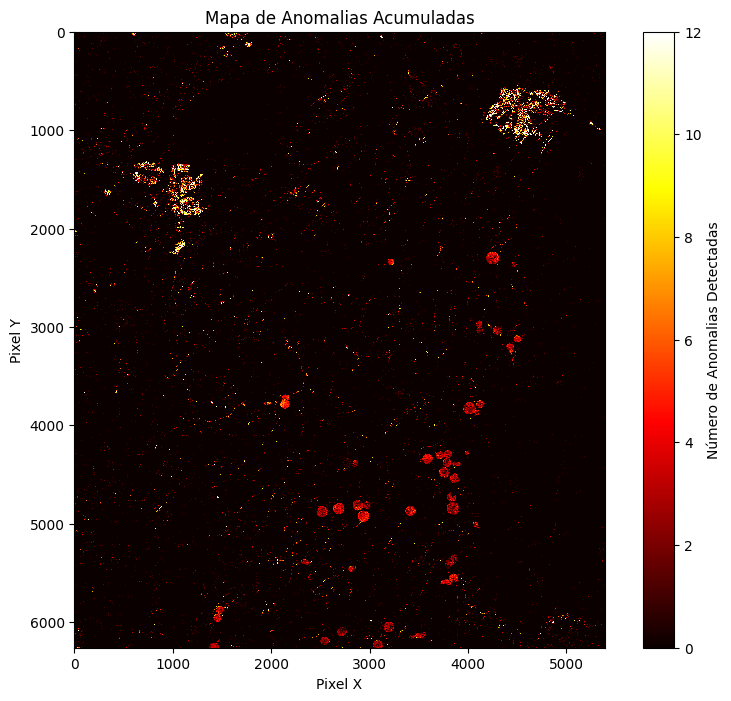

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import rasterio
from rasterio.transform import from_origin
from rasterio.crs import CRS

# Classe de interesse
classe = 3

# Inicializar uma matriz para armazenar a contagem de anomalias
anomalias_acumuladas = np.zeros_like(globals()[band_names[0]])

# Loop através dos pares de bandas
for i in range(0, len(band_names), 2):
    # Carregar bandas
    b1 = globals()[band_names[i]] # CO2
    b2 = globals()[band_names[i + 1]] # polarização em questão

    # Calculando os percentis
    percentil_inicial = 1
    percentil_final = 99

    '''
    Aqui define os percentis e
    normaliza as bandas para o intervalo [0, 1]
    '''

    limite_inferior_b1 = np.percentile(b1, percentil_inicial)
    limite_superior_b1 = np.percentile(b1, percentil_final)

    limite_inferior_b2 = np.percentile(b2, percentil_inicial)
    limite_superior_b2 = np.percentile(b2, percentil_final)

    # Aplicando a expansão do histograma e remapeamento para b1 e b2
    b1_expandido = (b1 - limite_inferior_b1) / (limite_superior_b1 - limite_inferior_b1)
    b1_expandido = np.clip(b1_expandido, 0, 1)

    b2_expandido = (b2 - limite_inferior_b2) / (limite_superior_b2 - limite_inferior_b2)
    b2_expandido = np.clip(b2_expandido, 0, 1)

    """
    Diferença entre as bandas
    dai atribui 1 para anomalias positivas e negativas
    """

    # Calculando a diferença bruta entre b1_expandido e b2_expandido para detecção de anomalias
    diferenca = b1_expandido - b2_expandido

    # Calculando os percentis para a diferença bruta
    limite_inferior_diferenca = np.percentile(diferenca, percentil_inicial)
    limite_superior_diferenca = np.percentile(diferenca, percentil_final)

    # Criando máscaras para anomalias positivas e negativas
    anomalias_positivas = diferenca > limite_superior_diferenca
    anomalias_negativas = diferenca < limite_inferior_diferenca

    # Criando uma máscara para valores que não são nem anomalias positivas nem negativas
    nao_anomalias = np.logical_not(np.logical_or(anomalias_positivas, anomalias_negativas))

    # Aplicando a máscara nos arrays originais cO2Flux e vv
    b1_sem_anomalias = np.where(nao_anomalias, b1, np.nan)
    b2_sem_anomalias = np.where(nao_anomalias, b2, np.nan)

    # Criar uma máscara para a classe
    mask_class = (subset_classes == classe)

    # Aplicar máscara às bandas
    b1_sem_anomalias_classe = np.where(mask_class, b1_sem_anomalias, np.nan)
    b2_sem_anomalias_classe = np.where(mask_class, b2_sem_anomalias, np.nan)

    # Adicionar anomalias ao acumulado
    anomalias_acumuladas += np.where(anomalias_positivas | anomalias_negativas, 1, 0)

# Visualizar o resultado acumulado das anomalias
plt.figure(figsize=(10, 8))
plt.imshow(anomalias_acumuladas, cmap='hot', interpolation='nearest')
plt.colorbar(label='Número de Anomalias Detectadas')
plt.title('Mapa de Anomalias Acumuladas')
plt.xlabel('Pixel X')
plt.ylabel('Pixel Y')
plt.show()

"""
O próximo é para salvar o arquivo TIFF.
"""

# Metadados para o arquivo TIFF
meta_optico = {
    'driver': 'GTiff',
    'dtype': 'int16',
    'nodata': 0,
    'width': 5390,
    'height': 6261,
    'count': 1,
    'crs': CRS.from_epsg(32722),
    'transform': from_origin(848402.0044, 8285872.0083, 10, -10)  # Origin and pixel size
}

# Ajustar a matriz de anomalias acumuladas para o tamanho enviado
anomalias_acumuladas_resized = np.resize(anomalias_acumuladas, (meta_optico['height'], meta_optico['width']))

# Salvar a matriz de anomalias acumuladas como um arquivo TIFF
with rasterio.open('anomalias_acumuladas.tif', 'w', **meta_optico) as dst:
    dst.write(anomalias_acumuladas_resized.astype(np.int16), 1)


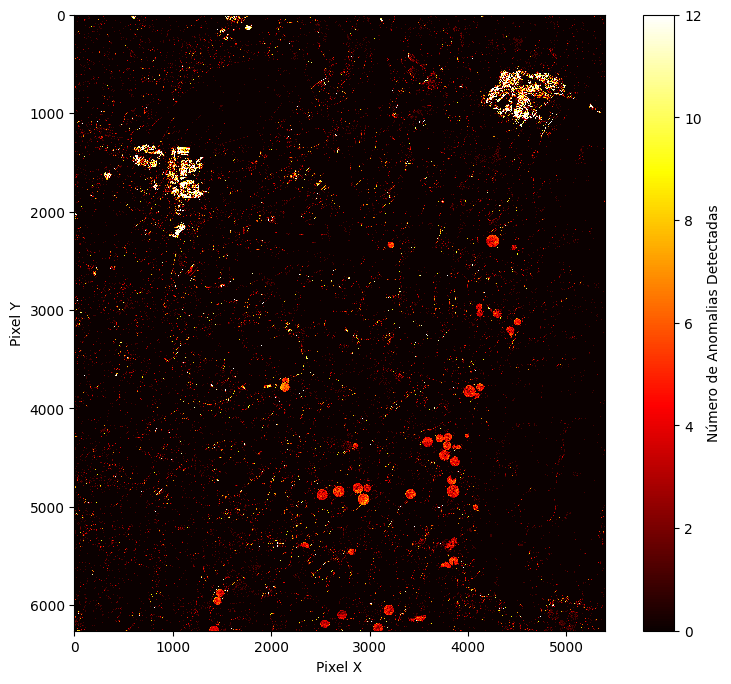

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import rasterio
from rasterio.transform import Affine
from rasterio.crs import CRS

# Classe de interesse
classe = 4

# Inicializar uma matriz para armazenar a contagem de anomalias
anomalias_acumuladas = np.zeros_like(globals()[band_names[0]])

# Loop através dos pares de bandas
for i in range(0, len(band_names), 2):
    # Carregar bandas
    b1 = globals()[band_names[i]] # CO2
    b2 = globals()[band_names[i + 1]] # VV

    # Calculando os percentis 2,5 e 97,5 para b1 e b2
    percentil_inicial = 1
    percentil_final = 99

    limite_inferior_b1 = np.percentile(b1, percentil_inicial)
    limite_superior_b1 = np.percentile(b1, percentil_final)

    limite_inferior_b2 = np.percentile(b2, percentil_inicial)
    limite_superior_b2 = np.percentile(b2, percentil_final)

    # Aplicando a expansão do histograma e remapeamento para b1 e b2
    b1_expandido = (b1 - limite_inferior_b1) / (limite_superior_b1 - limite_inferior_b1)
    b1_expandido = np.clip(b1_expandido, 0, 1)

    b2_expandido = (b2 - limite_inferior_b2) / (limite_superior_b2 - limite_inferior_b2)
    b2_expandido = np.clip(b2_expandido, 0, 1)

    # Calculando a diferença bruta entre b1_expandido e b2_expandido para detecção de anomalias
    diferenca = b1_expandido - b2_expandido

    # Calculando os percentis para a diferença bruta
    limite_inferior_diferenca = np.percentile(diferenca, percentil_inicial)
    limite_superior_diferenca = np.percentile(diferenca, percentil_final)

    # Criando máscaras para anomalias positivas e negativas
    anomalias_positivas = diferenca > limite_superior_diferenca
    anomalias_negativas = diferenca < limite_inferior_diferenca

    # Criando uma máscara para valores que não são nem anomalias positivas nem negativas
    nao_anomalias = np.logical_not(np.logical_or(anomalias_positivas, anomalias_negativas))

    # Aplicando a máscara nos arrays originais cO2Flux e vv
    b1_sem_anomalias = np.where(nao_anomalias, b1, np.nan)
    b2_sem_anomalias = np.where(nao_anomalias, b2, np.nan)

    # Criar uma máscara para a classe
    mask_class = (subset_classes == classe)

    # Aplicar máscara às bandas
    b1_sem_anomalias_classe = np.where(mask_class, b1_sem_anomalias, np.nan)
    b2_sem_anomalias_classe = np.where(mask_class, b2_sem_anomalias, np.nan)

    # Adicionar anomalias ao acumulado
    anomalias_acumuladas += np.where(anomalias_positivas | anomalias_negativas, 1, 0)

# Visualizar o resultado acumulado das anomalias
plt.figure(figsize=(10, 8))
plt.imshow(anomalias_acumuladas, cmap='hot', interpolation='nearest')
plt.colorbar(label='Número de Anomalias Detectadas')
#plt.title('Mapa de Anomalias Acumuladas')
plt.xlabel('Pixel X')
plt.ylabel('Pixel Y')
plt.savefig("DDA.png",dpi=300)
plt.show()

# Metadados para o arquivo TIFF
meta_optico = {
    'driver': 'GTiff',
    'dtype': 'int16',
    'nodata': 0,
    'width': 5390,
    'height': 6261,
    'count': 1,
    'crs': CRS.from_epsg(32722),
    'transform': Affine(10.0, 0.0, 848402.0044,
                        0.0, 10.0, 8223262.0083 - 6261 * 10.0)

}

# Ajustar a matriz de anomalias acumuladas para o tamanho desejado
anomalias_acumuladas_resized = np.resize(anomalias_acumuladas, (meta_optico['height'], meta_optico['width']))

# Salvar a matriz de anomalias acumuladas como um arquivo TIFF
with rasterio.open('anomalias_acumuladas2.tif', 'w', **meta_optico) as dst:
    dst.write(anomalias_acumuladas_resized.astype(np.int16), 1)

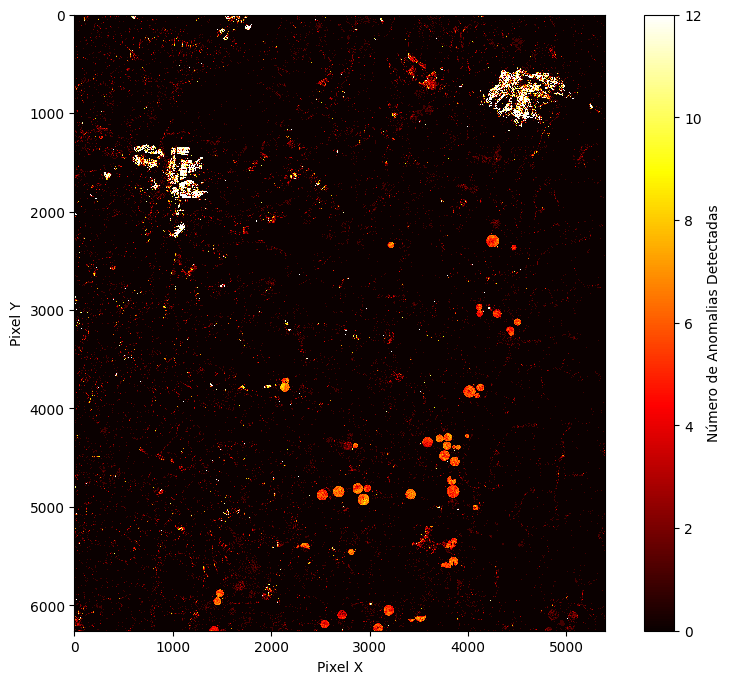

"\n# Metadados para o arquivo TIFF\nmeta_optico = {\n    'driver': 'GTiff',\n    'dtype': 'int16',\n    'nodata': 0,\n    'width': 5390,\n    'height': 6259,\n    'count': 1,\n    'crs': CRS.from_epsg(32722),\n'transform': Affine(10.0, 0.0, 848440.0,\n                    0.0, -10.0, 8285840.0) # Ajustado para corresponder ao raster de referência\n}\n\n# Ajustar a matriz de anomalias acumuladas para o tamanho desejado\nanomalias_acumuladas_resized = np.resize(anomalias_acumuladas, (meta_optico['height'], meta_optico['width']))\n\n# Salvar a matriz de anomalias acumuladas como um arquivo TIFF\nwith rasterio.open('anomalias_acumuladas2.tif', 'w', **meta_optico) as dst:\n    dst.write(anomalias_acumuladas_resized.astype(np.int16), 1)\n"

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import rasterio
from rasterio.transform import Affine
from rasterio.crs import CRS

# Classe de interesse
classe = 1

# Inicializar uma matriz para armazenar a contagem de anomalias
anomalias_acumuladas = np.zeros_like(globals()[band_names[0]])

# Loop através dos pares de bandas
for i in range(0, len(band_names), 2):
    # Carregar bandas
    b1 = globals()[band_names[i]] # CO2
    b2 = globals()[band_names[i + 1]] # VV

    # Calculando os percentis 2,5 e 97,5 para b1 e b2
    percentil_inicial = 1
    percentil_final = 99

    limite_inferior_b1 = np.percentile(b1, percentil_inicial)
    limite_superior_b1 = np.percentile(b1, percentil_final)

    limite_inferior_b2 = np.percentile(b2, percentil_inicial)
    limite_superior_b2 = np.percentile(b2, percentil_final)

    # Aplicando a expansão do histograma e remapeamento para b1 e b2
    b1_expandido = (b1 - limite_inferior_b1) / (limite_superior_b1 - limite_inferior_b1)
    b1_expandido = np.clip(b1_expandido, 0, 1)

    b2_expandido = (b2 - limite_inferior_b2) / (limite_superior_b2 - limite_inferior_b2)
    b2_expandido = np.clip(b2_expandido, 0, 1)

    # Calculando a diferença bruta entre b1_expandido e b2_expandido para detecção de anomalias
    diferenca = b1_expandido - b2_expandido

    # Calculando os percentis para a diferença bruta
    limite_inferior_diferenca = np.percentile(diferenca, percentil_inicial)
    limite_superior_diferenca = np.percentile(diferenca, percentil_final)

    # Criando máscaras para anomalias positivas e negativas
    anomalias_positivas = diferenca > limite_superior_diferenca
    anomalias_negativas = diferenca < limite_inferior_diferenca

    # Criando uma máscara para valores que não são nem anomalias positivas nem negativas
    nao_anomalias = np.logical_not(np.logical_or(anomalias_positivas, anomalias_negativas))

    # Aplicando a máscara nos arrays originais cO2Flux e vv
    b1_sem_anomalias = np.where(nao_anomalias, b1, np.nan)
    b2_sem_anomalias = np.where(nao_anomalias, b2, np.nan)

    # Criar uma máscara para a classe
    mask_class = (subset_classes == classe)

    # Aplicar máscara às bandas
    b1_sem_anomalias_classe = np.where(mask_class, b1_sem_anomalias, np.nan)
    b2_sem_anomalias_classe = np.where(mask_class, b2_sem_anomalias, np.nan)

    # Adicionar anomalias ao acumulado
    anomalias_acumuladas += np.where(anomalias_positivas | anomalias_negativas, 1, 0)

# Visualizar o resultado acumulado das anomalias
plt.figure(figsize=(10, 8))
plt.imshow(anomalias_acumuladas, cmap='hot', interpolation='nearest', extent=(0, anomalias_acumuladas.shape[1], anomalias_acumuladas.shape[0], 0))
plt.colorbar(label='Número de Anomalias Detectadas')
plt.xlabel('Pixel X')
plt.ylabel('Pixel Y')
plt.savefig("DDA.png", dpi=300, bbox_inches='tight', pad_inches=0)
plt.show()

"""
# Metadados para o arquivo TIFF
meta_optico = {
    'driver': 'GTiff',
    'dtype': 'int16',
    'nodata': 0,
    'width': 5390,
    'height': 6259,
    'count': 1,
    'crs': CRS.from_epsg(32722),
'transform': Affine(10.0, 0.0, 848440.0,
                    0.0, -10.0, 8285840.0) # Ajustado para corresponder ao raster de referência
}

# Ajustar a matriz de anomalias acumuladas para o tamanho desejado
anomalias_acumuladas_resized = np.resize(anomalias_acumuladas, (meta_optico['height'], meta_optico['width']))

# Salvar a matriz de anomalias acumuladas como um arquivo TIFF
with rasterio.open('anomalias_acumuladas2.tif', 'w', **meta_optico) as dst:
    dst.write(anomalias_acumuladas_resized.astype(np.int16), 1)
"""

In [ ]:
meta_optico

{'driver': 'GTiff',
 'dtype': 'int16',
 'nodata': 0,
 'width': 5390,
 'height': 6261,
 'count': 1,
 'crs': CRS.from_epsg(32722),
 'transform': Affine(10.0, 0.0, 848402.0044,
        0.0, -10.0, 8223262.0083)}

# **Segmentação**

In [ ]:
!pip install -q rasterio

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.5/21.5 MB 26.9 MB/s eta 0:00:00


In [ ]:
import logging
import rasterio
from rasterio.windows import Window
from rasterio.warp import reproject, Resampling
import numpy as np

# Ignorar avisos
logging.getLogger('rasterio').setLevel(logging.ERROR)

# Dicionário mapeando nomes de variáveis ​​para caminhos de arquivos
variables_dict = {
    'o0603op': '/content/drive/MyDrive/Subsets/0603 e 0608/CO2_SDWI_Laplaciano_S2A_MSIL2A_20220608.tif',
    'o0608SAR': '/content/drive/MyDrive/Subsets/0603 e 0608/S1A_IW_GRDH_1SDV_20220603.tif',

    'o0802op': '/content/drive/MyDrive/Subsets/0802 e 0802 (1)/CO2Flux_SDWI_Laplaciano_S2A_MSIL2A_20220802.tif',
    'o0802SAR': '/content/drive/MyDrive/Subsets/0802 e 0802/S1A_IW_GRDH_1SDV_20220802T084532_20220802T084557_044371_054B9B_0445_Orb_Cal_NR_ML_Spk_TC_dB.tif',

    'o1011op': '/content/drive/MyDrive/Subsets/1011 e 1013/CO2_SDWI_Laplaciano_S2B_MSIL2A_20221011T.tif',
    'o1013SAR': '/content/drive/MyDrive/Subsets/1011 e 1013/S1A_IW_GRDH_1SDV_20221013.tif'

}

# Lista para armazenar nomes de subconjuntos gerados
subset_names = []

# Determinear a área mínima de interseção (extensão)
intersecting_bounds = None
reference_transform = None
reference_crs = None

for var_name, scene_var in variables_dict.items():
    with rasterio.open(scene_var) as src_scene:
        if reference_transform is None:
            reference_transform = src_scene.transform
            reference_crs = src_scene.crs

        # Calcular a intersecção dos limites
        bounds = src_scene.bounds

        if intersecting_bounds is None:
            intersecting_bounds = bounds
        else:
            intersecting_bounds = (
                max(intersecting_bounds[0], bounds.left),
                min(intersecting_bounds[1], bounds.right),
                max(intersecting_bounds[2], bounds.bottom),
                min(intersecting_bounds[3], bounds.top)
            )

# Definir a largura e altura de referência com base nas menores dimensões encontradas
reference_width = 5390
reference_height = 6259

# Atualizar a transformação de referência e o CRS para corresponder à menor extensão
reference_transform = rasterio.transform.from_bounds(
    intersecting_bounds[0], intersecting_bounds[2], intersecting_bounds[1], intersecting_bounds[3],
    width=reference_width, height=reference_height
)

# Criar subconjuntos com a área de interseção mínima e faça nova amostragem para a mesma grade espacial
for var_name, scene_var in variables_dict.items():
    with rasterio.open(scene_var) as src_scene:
        # Ajustar a janela para a interseção mínima usando limites
        window = src_scene.window(*intersecting_bounds)
        window = window.round_offsets().round_shape()

        subset_name = f"subset_{var_name}"
        subset_data = src_scene.read(window=window)

        # Criar uma matriz de destino para reamostragem
        dst_data = np.empty((subset_data.shape[0], reference_height, reference_width), dtype=subset_data.dtype)

        # Reprojetar para a grade espacial de referência
        reproject(
            source=subset_data,
            destination=dst_data,
            src_transform=src_scene.window_transform(window),
            src_crs=src_scene.crs,
            dst_transform=reference_transform,
            dst_crs=reference_crs,
            resampling=Resampling.bilinear
        )

        globals()[subset_name] = dst_data

        # Adicionar o nome do subconjunto à lista
        subset_names.append(subset_name)

        # Ajustar os metadados para a nova janela
        meta_optico = src_scene.meta.copy()
        meta_optico.update({
            "height": reference_height,
            "width": reference_width,
            "count": dst_data.shape[0],  # Número total de bandas
            "transform": reference_transform,
            "crs": reference_crs
        })

# Printar a lista de nomes de subconjuntos gerados
print("Generated subsets:")
for name in subset_names:
    print(name)

# Metadata
print(meta_optico)


/usr/local/lib/python3.10/dist-packages/rasterio/windows.py:731: RasterioDeprecationWarning: round_shape is deprecated and will be removed in Rasterio 2.0.0.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/rasterio/windows.py:731: RasterioDeprecationWarning: round_shape is deprecated and will be removed in Rasterio 2.0.0.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/rasterio/windows.py:731: RasterioDeprecationWarning: round_shape is deprecated and will be removed in Rasterio 2.0.0.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/rasterio/windows.py:731: RasterioDeprecationWarning: round_shape is deprecated and will be removed in Rasterio 2.0.0.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/rasterio/windows.py:731: RasterioDeprecationWarning: round_shape is deprecated and will be removed in Rasterio 2.0.0.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/rasterio/windows.py:731: RasterioDeprecationWarning: round_shape is deprecated and wi

Generated subsets:
subset_o0603op
subset_o0608SAR
subset_o0802op
subset_o0802SAR
subset_o1011op
subset_o1013SAR
{'driver': 'GTiff', 'dtype': 'float32', 'nodata': None, 'width': 5390, 'height': 6259, 'count': 2, 'crs': CRS.from_epsg(32722), 'transform': Affine(10.0, 0.0, 848440.0,
       0.0, -9.99866551254748, 8285840.0)}


In [ ]:
# Criar as variáveis de banda específicas
band_names = []
for subset_name in subset_names:
    if 'op' in subset_name:
        globals()[f'{subset_name}_Laplaciano'] = globals()[subset_name][2]
        band_names.append(f'{subset_name}_Laplaciano')

# Imprimir a lista de nomes das bandas geradas
print("Bandas geradas:")
for name in band_names:
    print(name)

Bandas geradas:
subset_o0603op_Laplaciano
subset_o0802op_Laplaciano
subset_o1011op_Laplaciano


In [ ]:
# Loop em cada banda e remova os valores NaN
for name in band_names:
    band = globals()[name]
    if np.isnan(band).any():
        print(f"Removing NaN values from {name}...")
        band[np.isnan(band)] = 0  # NAN p/ 0
        globals()[name] = band  # Atualizar a variável com NaN removido
    else:
        print(f"No NaN values found in {name}")

# Print resultado
print("\nNaN values removed.")

Removing NaN values from subset_o0603op_Laplaciano...
No NaN values found in subset_o0802op_Laplaciano
No NaN values found in subset_o1011op_Laplaciano

NaN values removed.


## **Cubo de dados**

In [ ]:
images = [
    subset_o0603op_CO2Flux,
    subset_o0802op_CO2Flux,
    subset_o1011op_CO2Flux,
    subset_o0603op_SDWI,
    subset_o0802op_SDWI,
    subset_o1011op_SDWI,
    subset_o0603op_Laplaciano,
    subset_o0802op_Laplaciano,
    subset_o1011op_Laplaciano,
    subset_o0608SAR_VH,
    subset_o0802SAR_VH,
    subset_o1013SAR_VH,
    subset_o0608SAR_VV,
    subset_o0802SAR_VV,
    subset_o1013SAR_VV
]

# Empilhe as bandas em arrays
var_CO2_stack = np.dstack([images[0], images[1], images[2]])
var_SDWI_stack = np.dstack([images[3], images[4], images[5]])
var_VH_stack = np.dstack([images[9], images[10], images[11]])
var_VV_stack = np.dstack([images[12], images[13], images[14]])

var_CO2 = np.std(var_CO2_stack, axis=2)
var_SDWI = np.std(var_SDWI_stack, axis=2)
var_VH = np.std(var_VH_stack, axis=2)
var_VV = np.std(var_VV_stack, axis=2)

# Crie o array de pilha de imagens
image_stack = np.dstack([
    images[0], images[1], images[2],
    images[3], images[4], images[5],
    images[6], images[7], images[8],
    images[9], images[10], images[11],
    images[12], images[13], images[14],
    var_CO2,var_SDWI , var_VH, var_VV
])

# Verificar o formato do array
print(image_stack.shape)

'\nimages = [\n    subset_o0603op_CO2Flux,\n    subset_o0802op_CO2Flux,\n    subset_o1011op_CO2Flux,\n    subset_o0603op_SDWI,\n    subset_o0802op_SDWI,\n    subset_o1011op_SDWI,\n    subset_o0603op_Laplaciano,\n    subset_o0802op_Laplaciano,\n    subset_o1011op_Laplaciano,\n    subset_o0608SAR_VH,\n    subset_o0802SAR_VH,\n    subset_o1013SAR_VH,\n    subset_o0608SAR_VV,\n    subset_o0802SAR_VV,\n    subset_o1013SAR_VV\n]\n\n# Empilhe as bandas em arrays\nvar_CO2_stack = np.dstack([images[0], images[1], images[2]])\nvar_SDWI_stack = np.dstack([images[3], images[4], images[5]])\nvar_VH_stack = np.dstack([images[9], images[10], images[11]])\nvar_VV_stack = np.dstack([images[12], images[13], images[14]])\n\nvar_CO2 = np.std(var_CO2_stack, axis=2)\nvar_SDWI = np.std(var_SDWI_stack, axis=2)\nvar_VH = np.std(var_VH_stack, axis=2)\nvar_VV = np.std(var_VV_stack, axis=2)\n\n# Crie o array de pilha de imagens\nimage_stack = np.dstack([\n    images[0], images[1], images[2],\n    images[3], image

## **Continuação**

In [ ]:
images = [
    subset_o0603op_Laplaciano,
    subset_o0802op_Laplaciano,
    subset_o1011op_Laplaciano,
]


# Crie o array de pilha de imagens
image_stack = np.dstack([
    images[0], images[1], images[2],
])

# Verificar o formato do array
print(image_stack.shape)

(6259, 5390, 3)


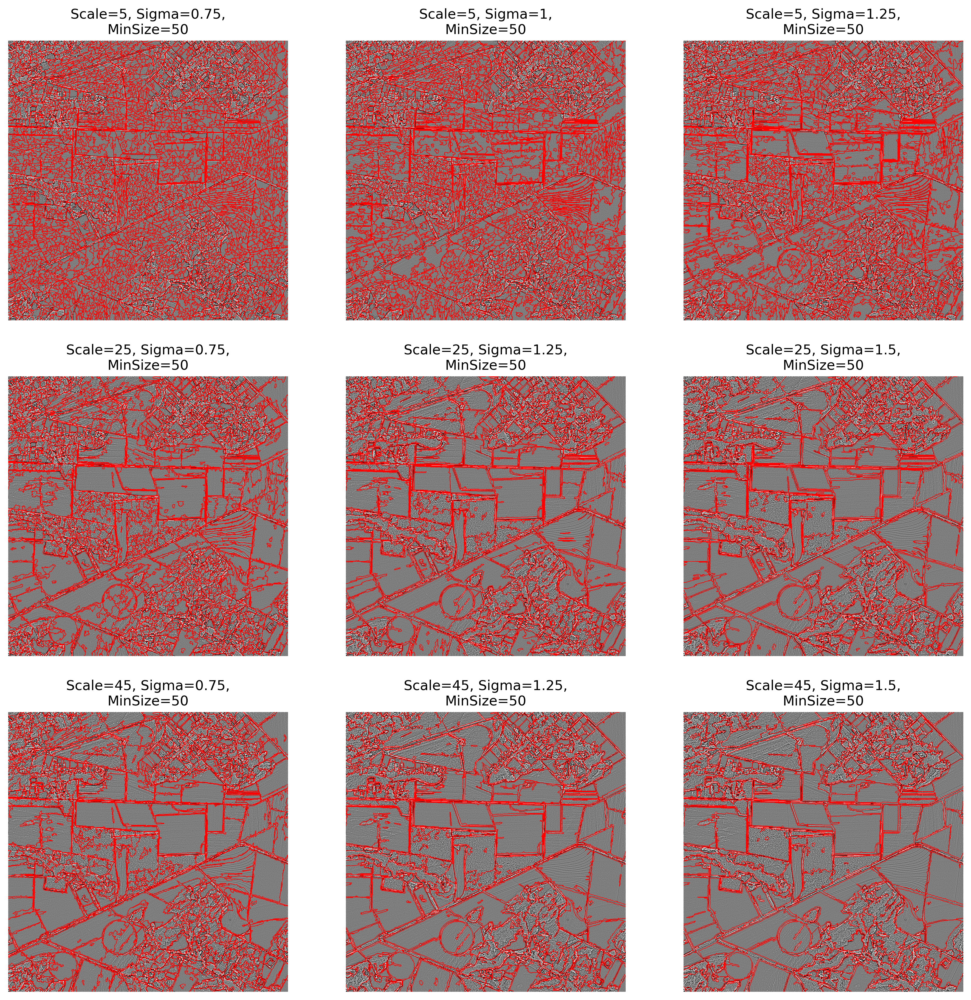

In [ ]:
import matplotlib.pyplot as plt
from skimage.segmentation import felzenszwalb, mark_boundaries
from skimage import data

# Seleção de uma sub-imagem do image_stack
image = image_stack[1800:2800, 1800:2800, :]

# Definir os diferentes conjuntos de parâmetros para segmentação
parameters = [
    {'scale': 5, 'sigma': 0.75, 'min_size': 50},
    {'scale': 5, 'sigma': 1, 'min_size': 50},
    {'scale': 5, 'sigma': 1.25, 'min_size': 50},
    {'scale': 25, 'sigma': 0.75, 'min_size': 50},
    {'scale': 25, 'sigma': 1.25, 'min_size': 50},
    {'scale': 25, 'sigma': 1.5, 'min_size': 50},
    {'scale': 45, 'sigma': 0.75, 'min_size': 50},
    {'scale': 45, 'sigma': 1.25, 'min_size': 50},
    {'scale': 45, 'sigma': 1.5, 'min_size': 50},
]

# Realizar as segmentações com diferentes parâmetros
segmentations = [felzenszwalb(image, **params) for params in parameters]

# Função de expansão
def expansao(img, percent_ini=5, percent_fim=95):
    s = np.zeros_like(img)
    x, y = 0, 1
    w = np.percentile(img, percent_ini)
    z = np.percentile(img, percent_fim)
    p = x + (img - w) * (y - x) / (z - w)
    p[p < x] = x
    p[p > y] = y
    s = p
    return s

# Plots
fig, ax = plt.subplots(3, 3, figsize=(15, 15), dpi=300)

# Mostrar as segmentações com limites marcados
for i, seg in enumerate(segmentations):
    row = i // 3
    col = i % 3
    ax[row, col].imshow(mark_boundaries(expansao(image[:, :, 2]), seg, color=(1, 0, 0)))
    ax[row, col].set_title(f'Scale={parameters[i]["scale"]}, Sigma={parameters[i]["sigma"]},\nMinSize={parameters[i]["min_size"]}')
    ax[row, col].axis('off')

plt.savefig('/content/Teste_de_Segmentos_Laplaciano.png', bbox_inches='tight', pad_inches=0)  # Salvar a imagem
plt.show()


In [ ]:
from skimage.segmentation import felzenszwalb
from skimage import exposure
import numpy as np
import rasterio as rio
from skimage.morphology import remove_small_objects

# Supondo que 'image_stack' e 'meta_optico' já foram definidos anteriormente

# Especificar a divisão da altura e largura da imagem
split_height = image_stack.shape[1] // 3  # Dividir a altura em três
split_width = image_stack.shape[0] // 3   # Dividir a largura em três

# Função para dividir a imagem em blocos
def dividir_imagem(image, split_width, split_height):
    blocks = []
    for i in range(3):  # 3 divisões na altura
        for j in range(3):  # 3 divisões na largura
            start_row = i * split_height
            end_row = (i + 1) * split_height if (i + 1) * split_height <= image.shape[1] else image.shape[1]
            start_col = j * split_width
            end_col = (j + 1) * split_width if (j + 1) * split_width <= image.shape[0] else image.shape[0]
            blocks.append(image[start_col:end_col, start_row:end_row, :])
    return blocks

# Dividir a imagem em blocos
blocks = dividir_imagem(image_stack, split_width, split_height)

# Reamostrar para valores de -1 a 1
blocks_reshaped = [exposure.rescale_intensity(block) for block in blocks]

# Criar segmentos para cada bloco com parâmetros ajustados e remover segmentos pequenos
segments = [felzenszwalb(block_reshaped, scale=25, sigma=0.75, min_size=50) for block_reshaped in blocks_reshaped]
segments_cleaned = [remove_small_objects(segment, min_size=50) for segment in segments]

# Função para combinar os segmentos em uma imagem final
def combinar_segmentos(segments_cleaned, split_width, split_height, original_shape):
    final_segments = np.zeros((original_shape[0], original_shape[1]), dtype=np.int32)
    for i in range(3):  # 3 divisões na altura
        for j in range(3):  # 3 divisões na largura
            start_row = i * split_height
            end_row = (i + 1) * split_height if (i + 1) * split_height <= original_shape[1] else original_shape[1]
            start_col = j * split_width
            end_col = (j + 1) * split_width if (j + 1) * split_width <= original_shape[0] else original_shape[0]
            block_idx = i * 3 + j
            final_segments[start_col:end_col, start_row:end_row] = segments_cleaned[block_idx]
    return final_segments

# Combinar os segmentos dos blocos
final_segments = combinar_segmentos(segments_cleaned, split_width, split_height, image_stack.shape)

# Gravar os segmentos combinados em disco
meta_optico.update({'count': 1})
with rio.open(f'/content/drive/MyDrive/Certa/Segmentacao/Segmentos_Laplaciano_25_075_50.tif', 'w', **meta_optico) as src:
    src.write(final_segments, 1)

print('Segmentação concluída e salva.')

Segmentação concluída e salva.


In [ ]:
# Função para combinar os segmentos em uma imagem final
def combinar_segmentos(segments_cleaned, split_width, split_height, original_shape):
    final_segments = np.zeros((original_shape[0], original_shape[1]), dtype=np.int32)
    for i in range(4):  # 4 divisões na altura
        for j in range(2):  # 2 divisões na largura
            start_row = i * split_height
            end_row = (i + 1) * split_height if (i + 1) * split_height <= original_shape[1] else original_shape[1]
            start_col = j * split_width
            end_col = (j + 1) * split_width if (j + 1) * split_width <= original_shape[0] else original_shape[0]
            block_idx = i * 2 + j
            final_segments[start_col:end_col, start_row:end_row] = segments_cleaned[block_idx]
    return final_segments

# Combinar os segmentos dos blocos
final_segments = combinar_segmentos(segments_cleaned, split_width, split_height, image_stack.shape)

# Gravar os segmentos combinados em disco
meta_optico.update({'count': 1})
with rio.open(f'/content/drive/MyDrive/Certa/Segmentacao/Segmentos_Laplaciano_50.tif', 'w', **meta_optico) as src:
    src.write(final_segments, 1)

print('Segmentação concluída e salva.')

Segmentação concluída e salva.


In [ ]:
# Função para poligonizar raster
def polygonize(raster_file,shp_path):
  img = gdal.Open(raster_file)
  dn = img.GetRasterBand(1)
  shp_driver = ogr.GetDriverByName("ESRI Shapefile")

  shape_out = shp_driver.CreateDataSource(shp_path)
  srs = ogr.osr.SpatialReference()
  srs.ImportFromEPSG(32722)
  novo_shape = shape_out.CreateLayer('segs.shp', srs = srs)
  gdal.Polygonize(dn, None, novo_shape, -1, [], callback=None)
  shape_out.Destroy()
  return print('Polígonos criados!')

In [ ]:
from osgeo import gdal, ogr

polygonize(f'/content/drive/MyDrive/Certa/Segmentacao/Segmentos_Laplaciano_25_075_50.tif',f'/content/drive/MyDrive/Certa/Segmentacao/Segmentos_Laplaciano_25_075_50.shp')

Polígonos criados!


# **Classificação**

In [ ]:
# Carregar o shapefile
gdf = gpd.read_file('/content/drive/MyDrive/Certa/Atributos/Segmentos_Laplaciano_25_075_50_Atributos.shp')

In [ ]:
gdf.columns

Index(['FID', 'b1_mean', 'b1_median', 'b1_stdev', 'b1_min', 'b1_max',
       'b1_range', 'b2_mean', 'b2_median', 'b2_stdev',
       ...
       'b19_mean', 'b19_median', 'b19_stdev', 'b19_min', 'b19_max',
       'b19_range', 'Area', 'Forma', 'Amostras', 'geometry'],
      dtype='object', length=119)

In [ ]:
import tensorflow as tf
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, confusion_matrix, precision_score, recall_score, f1_score

alvo = "Amostras"
df = gdf

# Criar o gdf_sample para as linhas em que 'Amostras' não são NaN
gdf_sample = df.dropna(subset=[alvo])

# Extrair as features e as amostras (alvo)
X = gdf_sample.drop(columns=['FID', 'geometry', alvo])
y = gdf_sample[alvo]

# Normalizar as features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# One-hot encode para as amostras
y_one_hot = pd.get_dummies(y)

# Divisão estratificada garantindo que 30% de cada classe esteja no conjunto de teste
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y_one_hot, test_size=0.3, stratify=y, random_state=42)

# Construir o modelo de rede neural para classificação
model = tf.keras.models.Sequential([
    tf.keras.layers.Dense(128, activation='relu', input_shape=(X_train.shape[1],)),
    tf.keras.layers.Dropout(0.5),  # Adicionando regularização de dropout
    tf.keras.layers.Dense(64, activation='relu'),
    tf.keras.layers.Dropout(0.5),  # Adicionando regularização de dropout
    tf.keras.layers.Dense(y_one_hot.shape[1], activation='softmax')  # Camada de saída para classificação multiclasse com ativação softmax
])

# Compilar o modelo
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Parada antecipada ancorada na perda de validação para evitar overfitting
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

# Treinamento
history = model.fit(X_train, y_train, epochs=100, batch_size=32, validation_split=0.3, callbacks=[early_stopping])

# Avaliação do modelo
y_pred_proba = model.predict(X_test)
y_pred = np.argmax(y_pred_proba, axis=1)  # Convert probabilities to class labels

# Calcular as métricas
accuracy = accuracy_score(np.argmax(y_test.values, axis=1), y_pred)
conf_matrix = confusion_matrix(np.argmax(y_test.values, axis=1), y_pred)
precision = precision_score(np.argmax(y_test.values, axis=1), y_pred, average='weighted')
recall = recall_score(np.argmax(y_test.values, axis=1), y_pred, average='weighted')
f1 = f1_score(np.argmax(y_test.values, axis=1), y_pred, average='weighted')

# Print the results
print("Neural Network Results:")
print("Accuracy:", accuracy)
print("Confusion Matrix:")
print(conf_matrix)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1)


Epoch 1/100
5/5 [==============================] - 1s 67ms/step - loss: 2.1941 - accuracy: 0.1161 - val_loss: 1.5590 - val_accuracy: 0.2537
Epoch 2/100
5/5 [==============================] - 0s 16ms/step - loss: 1.7275 - accuracy: 0.2581 - val_loss: 1.3263 - val_accuracy: 0.3582
Epoch 3/100
5/5 [==============================] - 0s 12ms/step - loss: 1.5900 - accuracy: 0.3677 - val_loss: 1.1621 - val_accuracy: 0.5522
Epoch 4/100
5/5 [==============================] - 0s 16ms/step - loss: 1.4150 - accuracy: 0.4645 - val_loss: 1.0451 - val_accuracy: 0.7164
Epoch 5/100
5/5 [==============================] - 0s 15ms/step - loss: 1.1644 - accuracy: 0.5419 - val_loss: 0.9487 - val_accuracy: 0.7313
Epoch 6/100
5/5 [==============================] - 0s 16ms/step - loss: 1.0019 - accuracy: 0.6194 - val_loss: 0.8698 - val_accuracy: 0.7313
Epoch 7/100
5/5 [==============================] - 0s 17ms/step - loss: 0.9151 - accuracy: 0.6645 - val_loss: 0.8118 - val_accuracy: 0.7313
Epoch 8/100
5/5 [===

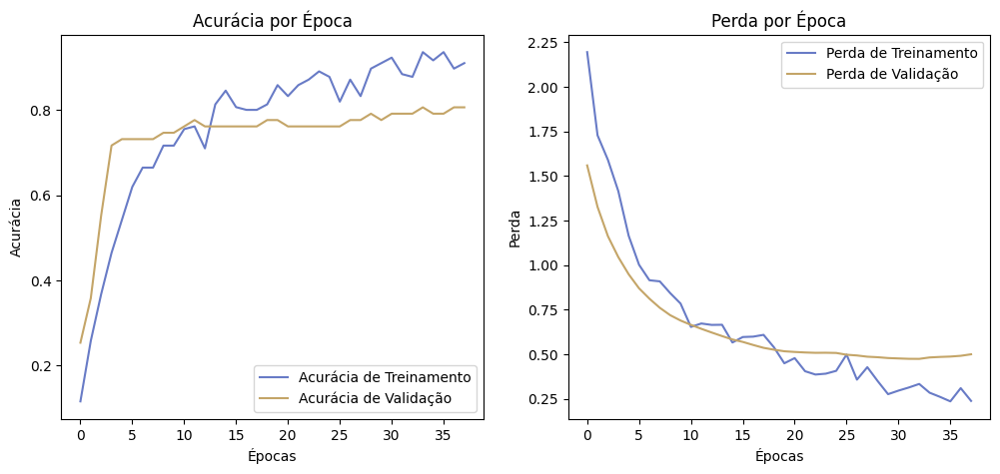

In [ ]:
import matplotlib.pyplot as plt

# Plotar a acurácia de treino e validação ao longo das épocas
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Acurácia de Treinamento', color='#687BC6')
plt.plot(history.history['val_accuracy'], label='Acurácia de Validação', color='#c4a568')
plt.title('Acurácia por Época')
plt.xlabel('Épocas')
plt.ylabel('Acurácia')
plt.legend()

# Plotar a perda de treino e validação ao longo das épocas
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Perda de Treinamento', color='#687BC6')
plt.plot(history.history['val_loss'], label='Perda de Validação', color='#c4a568')
plt.title('Perda por Época')
plt.xlabel('Épocas')
plt.ylabel('Perda')
plt.legend()

plot_path = '/content/Metricas.png'
plt.savefig(plot_path, dpi=300, bbox_inches='tight')

plt.show()


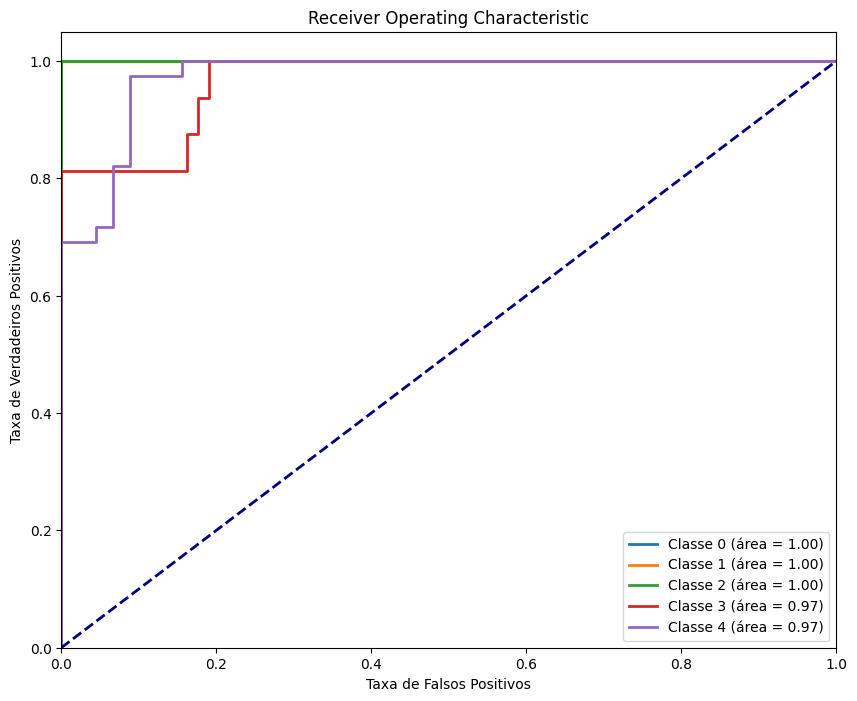

In [ ]:
from sklearn.metrics import roc_curve, auc

plt.figure(figsize=(10, 8))

for i in range(y_one_hot.shape[1]):
    fpr, tpr, _ = roc_curve(y_test.values[:, i], y_pred_proba[:, i])
    roc_auc = auc(fpr, tpr)
    plt.plot(fpr, tpr, lw=2, label='Classe %d (área = %0.2f)' % (i, roc_auc))

plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('Taxa de Falsos Positivos')
plt.ylabel('Taxa de Verdadeiros Positivos')
plt.title('Receiver Operating Characteristic')
plt.legend(loc="lower right")
plt.show()


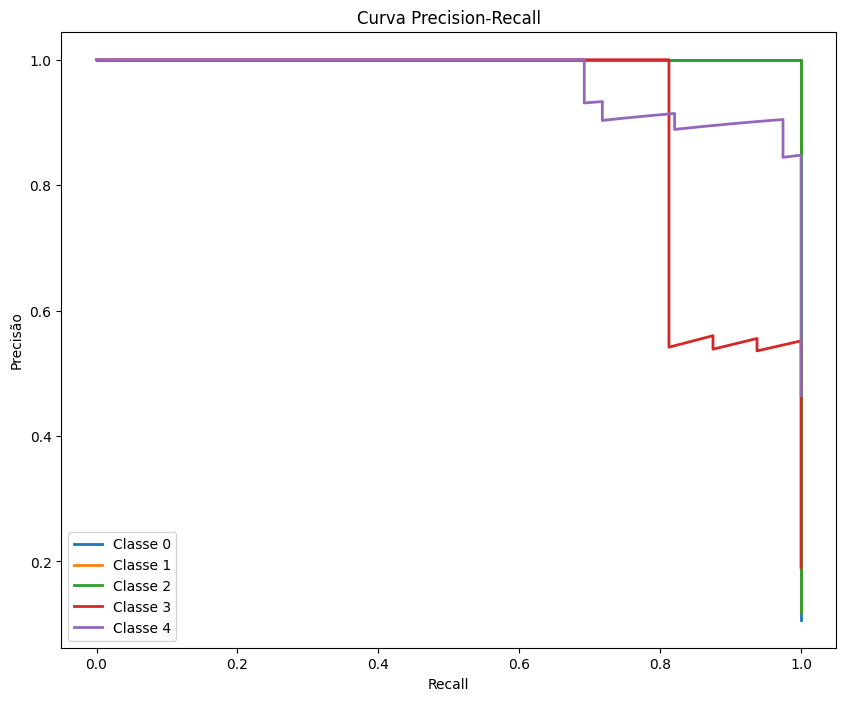

In [ ]:
from sklearn.metrics import precision_recall_curve

plt.figure(figsize=(10, 8))

for i in range(y_one_hot.shape[1]):
    precision, recall, _ = precision_recall_curve(y_test.values[:, i], y_pred_proba[:, i])
    plt.plot(recall, precision, lw=2, label='Classe %d' % i)

plt.xlabel('Recall')
plt.ylabel('Precisão')
plt.title('Curva Precision-Recall')
plt.legend(loc="best")
plt.show()


5927/5927 [==============================] - 14s 2ms/step


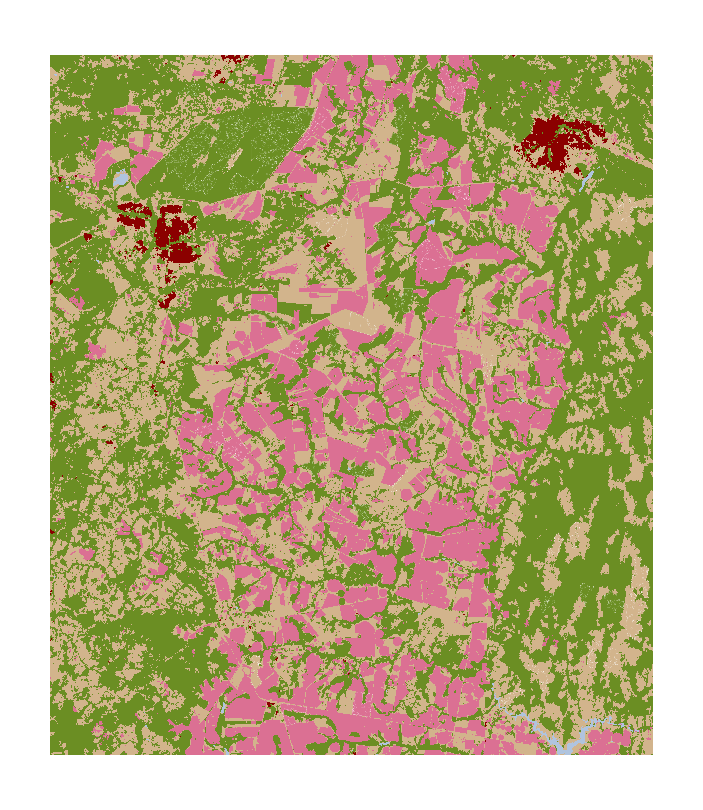

In [ ]:
import geopandas as gpd
import numpy as np
import pandas as pd
import tensorflow as tf
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
import matplotlib.colors as mcolors


cmap = mcolors.ListedColormap(['palevioletred', 'darkred', 'olivedrab', 'tan', 'lightsteelblue'])

# Create a subset gdf_sample for rows where 'Amostras' is not NaN
gdf_sample = df.dropna(subset=[alvo])

# Extract features and target variable for gdf_sample
X_sample = gdf_sample.drop(columns=['FID', 'geometry', alvo])
y_sample = gdf_sample[alvo]

# Normalizar as features
scaler = StandardScaler()
scaler.fit(X_sample)  # Ajustar o escalonador aos dados de amostra

# Prepare todo o conjunto de dados para classificação
X_all = df.drop(columns=['FID', 'geometry', alvo])
X_all_scaled = scaler.transform(X_all)

# Prever as classes para todo o conjunto de dados
y_pred_proba_all = model.predict(X_all_scaled)
y_pred_all = np.argmax(y_pred_proba_all, axis=1)

# Adicionar as previsões ao GeoDataFrame original
df['predicted'] = y_pred_all

# Selecionar apenas as colunas necessárias
gdf_classified = df[['FID', 'predicted', 'geometry']]

# salvar em shp
classified_shapefile_path = '/content/drive/MyDrive/Certa/Classificados/Segmentos_Laplaciano_25_075_50_Atributos_Classificados.shp'
gdf_classified.to_file(classified_shapefile_path)

# Viuzalização
fig, ax = plt.subplots(figsize=(5, 5), dpi=200)
df.plot(column='predicted', ax=ax, legend=False, cmap=cmap)
ax.set_axis_off()

# Salvar
plot_path = '/content/drive/MyDrive/Certa/Classificados/Segmentos_Laplaciano_25_075_50_Atributos_Classificados.png'
plt.savefig(plot_path, dpi=300, bbox_inches='tight')


# **QQ-plot**

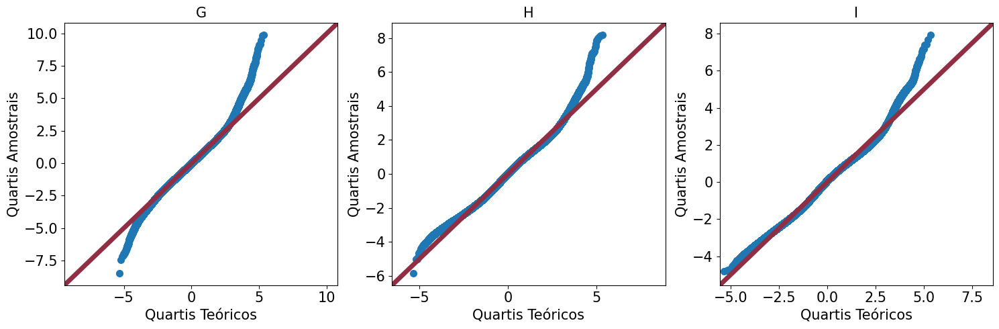

In [ ]:
import matplotlib.pyplot as plt
import statsmodels.api as sm
import numpy as np
import gc

# Função para criar um QQ plot
def qqplot(data, ax, title, point_size, line_width, font_size, xlabel, ylabel):
    sm.qqplot(data, line='45', fit=True, ax=ax)
    ax.get_lines()[0].set_markersize(point_size)  # Ajustar tamanho dos pontos
    ax.get_lines()[1].set_linewidth(line_width)  # Ajustar largura das linhas
    ax.get_lines()[0].set_color('#405dc4')  # Ajustar cor dos pontos
    ax.get_lines()[1].set_color('#902e44')  # Ajustar cor da linha
    ax.set_title(title, fontsize=font_size)  # Ajustar tamanho da fonte do título
    ax.set_xlabel(xlabel, fontsize=font_size)  # Ajustar o rótulo do eixo X
    ax.set_ylabel(ylabel, fontsize=font_size)  # Ajustar o rótulo do eixo Y
    ax.tick_params(axis='both', which='major', labelsize=font_size)  # Ajustar tamanho da fonte dos eixos

# Classe de interesse
classes = [1, 3]

# Garantir que a variável 'subset_classes' esteja carregada
subset_classes = globals()['subset_classes']

# Função para aplicar a máscara de classes
def apply_class_mask(band, classes):
    mask = np.isin(subset_classes, classes)
    masked_data = band[mask]
    return masked_data

# Lista de bandas CO2Flux
vh_bands = ['subset_o0608SAR_VH', 'subset_o0802SAR_VH', 'subset_o1013SAR_VH']

# Parâmetros do gráfico
point_size = 7  # Tamanho dos pontos no QQ plot
line_width = 5  # Largura das linhas no QQ plot
font_size = 15  # Tamanho da fonte dos títulos e eixos
axis_label_size = 15  # Tamanho da fonte dos rótulos dos eixos

# Criar figura e eixos
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

# Lista de títulos
titles = ['G', 'H', 'I']
# Rótulos dos eixos
xlabels = ['Quartis Teóricos'] * 3
ylabels = ['Quartis Amostrais'] * 3

# Loop para criar QQ plots
for j in range(3):
    band_name = vh_bands[j]
    band_data = globals()[band_name]

    # Aplicar máscara de classes
    masked_data = apply_class_mask(band_data, classes)
    masked_data = masked_data[~np.isnan(masked_data)]  # Remover valores NaN

    title = titles[j]
    xlabel = xlabels[j]
    ylabel = ylabels[j]

    qqplot(masked_data, axs[j], title, point_size, line_width, font_size, xlabel, ylabel)

    # Limpeza de memória
    del band_data, masked_data
    gc.collect()

# Ajustar layout
plt.tight_layout()

# Salvar a figura no Google Drive
plt.savefig('/content/qqplots_VV.png', dpi=300)

# Mostrar a figura
plt.show()


# **Amostras**

<ipython-input-3-39cb234dedf9>:249: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


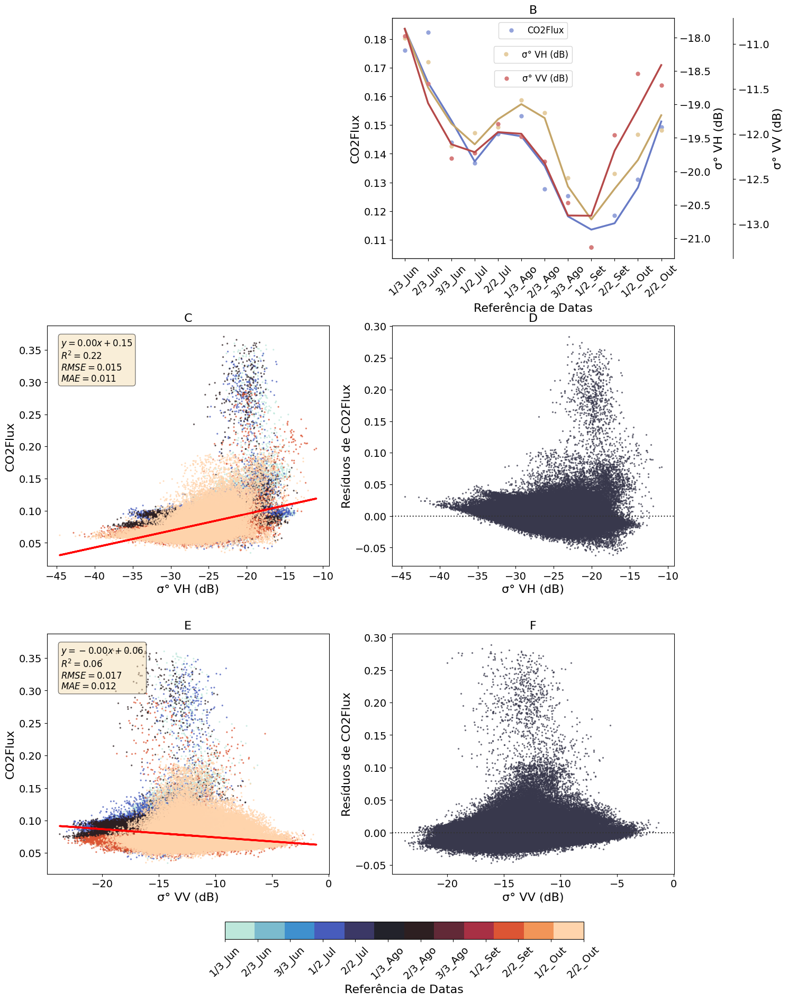

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from scipy.signal import savgol_filter

# List of classes to iterate over
lista = [33]

# Referências de datas
referencias = ["1/3_Jun", "2/3_Jun", "3/3_Jun", "1/2_Jul", "2/2_Jul", "1/3_Ago", "2/3_Ago", "3/3_Ago", "1/2_Set", "2/2_Set", "1/2_Out", "2/2_Out"]

# Adjustable parameters
font_size_large = 16
font_size_small = 12
scatter_point_size = 2
line_width = 2.5
line_point_size = 5
axis_font_size = 14
colorbar_font_size = 14

for classe in lista:
    # Garantir que a variável 'subset_classes' esteja carregada
    subset_classes = globals()['subset_classes']

    # Inicializar as listas para os valores de cada gráfico
    x_VH = []
    y_CO2_VH = []
    x_VV = []
    y_CO2_VV = []
    colors = []

    # Definir a paleta de cores quente-frio
    palette = plt.get_cmap('icefire', len(referencias))

    # Loop através dos conjuntos de bandas
    for i in range(0, len(band_names), 3):
        # Carregar bandas
        cO2 = globals()[band_names[i]]
        VH = globals()[band_names[i + 1]]
        VV = globals()[band_names[i + 2]]

        # Criar uma máscara para a classe
        mask_class = (subset_classes == classe)

        # Aplicar máscara às bandas
        b1_sem_anomalias_classe = np.where(mask_class, cO2, np.nan)
        b2_sem_anomalias_classe_VH = np.where(mask_class, VH, np.nan)
        b2_sem_anomalias_classe_VV = np.where(mask_class, VV, np.nan)

        # Flatten the arrays and remove NaN values for VH
        x_band_VH = b2_sem_anomalias_classe_VH.flatten()
        y_band_CO2_VH = b1_sem_anomalias_classe.flatten()

        # Mask to handle only values between -1 and 1 in y
        valid_mask_range_VH = (y_band_CO2_VH >= -1) & (y_band_CO2_VH <= 1)

        # Combining NaN mask and range mask for VH
        valid_mask_VH = ~np.isnan(x_band_VH) & ~np.isnan(y_band_CO2_VH) & valid_mask_range_VH
        x_band_VH = x_band_VH[valid_mask_VH]
        y_band_CO2_VH = y_band_CO2_VH[valid_mask_VH]

        if x_band_VH.size == 0 or y_band_CO2_VH.size == 0:
            print(f"No valid data points found for band pair {i*3+2} and {i*3+1}")
            continue

        # Append data to lists for VH
        x_VH.extend(x_band_VH)
        y_CO2_VH.extend(y_band_CO2_VH)
        colors.extend([palette(i)] * len(x_band_VH))

        # Flatten the arrays and remove NaN values for VV
        x_band_VV = b2_sem_anomalias_classe_VV.flatten()
        y_band_CO2_VV = b1_sem_anomalias_classe.flatten()

        # Mask to handle only values between -1 and 1 in y
        valid_mask_range_VV = (y_band_CO2_VV >= -1) & (y_band_CO2_VV <= 1)

        # Combining NaN mask and range mask for VV
        valid_mask_VV = ~np.isnan(x_band_VV) & ~np.isnan(y_band_CO2_VV) & valid_mask_range_VV
        x_band_VV = x_band_VV[valid_mask_VV]
        y_band_CO2_VV = y_band_CO2_VV[valid_mask_VV]

        if x_band_VV.size == 0 or y_band_CO2_VV.size == 0:
            print(f"No valid data points found for band pair {i*3+3} and {i*3+1}")
            continue

        # Append data to lists for VV
        x_VV.extend(x_band_VV)
        y_CO2_VV.extend(y_band_CO2_VV)
        colors.extend([palette(i)] * len(x_band_VV))

    # Converter a lista para array
    x_VH = np.array(x_VH)
    y_CO2_VH = np.array(y_CO2_VH)
    x_VV = np.array(x_VV)
    y_CO2_VV = np.array(y_CO2_VV)
    colors = np.array(colors[:len(x_VH)])  # Ajustar o tamanho da lista de cores

    # Ajustar um modelo de regressão linear para VH
    x_reshaped_VH = x_VH.reshape(-1, 1)
    model_VH = LinearRegression().fit(x_reshaped_VH, y_CO2_VH)
    predicted_values_VH = model_VH.predict(x_reshaped_VH)

    # Ajustar um modelo de regressão linear para VV
    x_reshaped_VV = x_VV.reshape(-1, 1)
    model_VV = LinearRegression().fit(x_reshaped_VV, y_CO2_VV)
    predicted_values_VV = model_VV.predict(x_reshaped_VV)

    # Calcular métricas para VH
    r2_VH = r2_score(y_CO2_VH, predicted_values_VH)
    rmse_VH = np.sqrt(mean_squared_error(y_CO2_VH, predicted_values_VH))
    mae_VH = mean_absolute_error(y_CO2_VH, predicted_values_VH)

    # Calcular métricas para VV
    r2_VV = r2_score(y_CO2_VV, predicted_values_VV)
    rmse_VV = np.sqrt(mean_squared_error(y_CO2_VV, predicted_values_VV))
    mae_VV = mean_absolute_error(y_CO2_VV, predicted_values_VV)

    # Criar a figura e os eixos
    fig, axs = plt.subplots(3, 2, figsize=(15, 20))

    # Subplot em branco (1, 1)
    axs[0, 0].axis('off')  # Desabilitar o eixo

    # Plotar a evolução dos valores (1, 2)
    mean_band1 = []
    mean_band2_VH = []
    mean_band2_VV = []

    for i in range(0, len(band_names), 3):
        cO2 = globals()[band_names[i]]
        VH = globals()[band_names[i + 1]]
        VV = globals()[band_names[i + 2]]

        random_indices = np.random.choice(np.arange(cO2.size), size=50, replace=False)
        mean_band1.append(np.nanmean(cO2.flatten()[random_indices]))
        mean_band2_VH.append(np.nanmean(VH.flatten()[random_indices]))
        mean_band2_VV.append(np.nanmean(VV.flatten()[random_indices]))

    smooth_band1 = savgol_filter(mean_band1[:len(referencias)], 5, 2)
    smooth_band2_VH = savgol_filter(mean_band2_VH[:len(referencias)], 5, 2)
    smooth_band2_VV = savgol_filter(mean_band2_VV[:len(referencias)], 5, 2)

    ax_evol = axs[0, 1]
    ax_evol.plot(referencias, mean_band1[:len(referencias)], 'o', label='CO2Flux', color='#95a4db', markersize=line_point_size)
    ax_evol.plot(referencias, smooth_band1, color='#687BC6', linestyle='-', linewidth=line_width)
    ax_evol.set_ylabel('CO2Flux', color='black', fontsize=font_size_large)
    ax_evol.tick_params(axis='y', labelcolor='black', labelsize=axis_font_size)

    ax_evol_vh = ax_evol.twinx()
    ax_evol_vh.plot(referencias, mean_band2_VH[:len(referencias)], 'o', label='σ° VH (dB)', color='#e5cda0', markersize=line_point_size)
    ax_evol_vh.plot(referencias, smooth_band2_VH, color='#c4a568', linestyle='-', linewidth=line_width)
    ax_evol_vh.set_ylabel('σ° VH (dB)', color='black', fontsize=font_size_large)
    ax_evol_vh.tick_params(axis='y', labelcolor='black', labelsize=axis_font_size)

    ax_evol_vv = ax_evol.twinx()
    ax_evol_vv.spines['right'].set_position(('outward', 80))
    ax_evol_vv.plot(referencias, mean_band2_VV[:len(referencias)], 'o', label='σ° VV (dB)', color='#d67c7c', markersize=line_point_size)
    ax_evol_vv.plot(referencias, smooth_band2_VV, color='#b54949', linestyle='-', linewidth=line_width)
    ax_evol_vv.set_ylabel('σ° VV (dB)', color='black', fontsize=font_size_large)
    ax_evol_vv.tick_params(axis='y', labelcolor='black', labelsize=axis_font_size)

    ax_evol.set_xlabel('Referência de Datas', fontsize=font_size_large)
    ax_evol.set_title('B', fontsize=font_size_large)
    ax_evol.tick_params(axis='x', labelsize=axis_font_size, labelrotation=45)

    ax_evol.legend(loc='upper center', fontsize=font_size_small, bbox_to_anchor=(0.5, 1.0))  # Mantém a posição atual
    ax_evol_vh.legend(loc='upper center', fontsize=font_size_small, bbox_to_anchor=(0.5, 0.9))  # Desce 0.1
    ax_evol_vv.legend(loc='upper center', fontsize=font_size_small, bbox_to_anchor=(0.5, 0.8))  # Desce 0.2

    # Plotar o dispersograma CO2Flux vs VH (2, 1)
    axs[1, 0].scatter(x_VH, y_CO2_VH, c=colors, alpha=0.6, s=scatter_point_size)
    axs[1, 0].plot(x_VH, predicted_values_VH, color='red', linewidth=line_width)
    axs[1, 0].set_xlabel('σ° VH (dB)', fontsize=font_size_large)
    axs[1, 0].set_ylabel('CO2Flux', fontsize=font_size_large)
    axs[1, 0].set_title('C', fontsize=font_size_large)
    axs[1, 0].tick_params(axis='x', labelsize=axis_font_size)
    axs[1, 0].tick_params(axis='y', labelsize=axis_font_size)

    # Calcular a equação da regressão linear para VH
    intercept_VH = model_VH.intercept_
    slope_VH = model_VH.coef_[0]

    # Adicionar caixa de texto com métricas para VH
    textstr_VH = '\n'.join((
        f'$y = {slope_VH:.2f}x + {intercept_VH:.2f}$',
        f'$R^2={r2_VH:.2f}$',
        f'$RMSE={rmse_VH:.3f}$',
        f'$MAE={mae_VH:.3f}$'))

    props = dict(boxstyle='round', facecolor='wheat', alpha=0.5)
    axs[1, 0].text(0.05, 0.95, textstr_VH, transform=axs[1, 0].transAxes, fontsize=font_size_small,
                   verticalalignment='top', bbox=props)

    # Plotar o gráfico de resíduos CO2Flux vs VH (2, 2)
    sns.residplot(x=x_VH, y=y_CO2_VH, color="#38384c", lowess=False, line_kws=dict(color="r"), ax=axs[1, 1], scatter_kws={'s': scatter_point_size, 'alpha': 0.6})
    axs[1, 1].set_xlabel('σ° VH (dB)', fontsize=font_size_large)
    axs[1, 1].set_ylabel('Resíduos de CO2Flux', fontsize=font_size_large)
    axs[1, 1].set_title('D', fontsize=font_size_large)
    axs[1, 1].tick_params(axis='x', labelsize=axis_font_size)
    axs[1, 1].tick_params(axis='y', labelsize=axis_font_size)

    # Plotar o dispersograma CO2Flux vs VV (3, 1)
    axs[2, 0].scatter(x_VV, y_CO2_VV, c=colors, alpha=0.6, s=scatter_point_size)
    axs[2, 0].plot(x_VV, predicted_values_VV, color='red', linewidth=line_width)
    axs[2, 0].set_xlabel('σ° VV (dB)', fontsize=font_size_large)
    axs[2, 0].set_ylabel('CO2Flux', fontsize=font_size_large)
    axs[2, 0].set_title('E', fontsize=font_size_large)
    axs[2, 0].tick_params(axis='x', labelsize=axis_font_size)
    axs[2, 0].tick_params(axis='y', labelsize=axis_font_size)

    # Calcular a equação da regressão linear para VV
    intercept_VV = model_VV.intercept_
    slope_VV = model_VV.coef_[0]

    # Adicionar caixa de texto com métricas e equação para VV
    textstr_VV = '\n'.join((
        f'$y = {slope_VV:.2f}x + {intercept_VV:.2f}$',
        f'$R^2={r2_VV:.2f}$',
        f'$RMSE={rmse_VV:.3f}$',
        f'$MAE={mae_VV:.3f}$',
    ))
    props = dict(boxstyle='round', facecolor='wheat', alpha=0.5)
    axs[2, 0].text(0.05, 0.95, textstr_VV, transform=axs[2, 0].transAxes, fontsize=font_size_small,
                  verticalalignment='top', bbox=props)

    # Plotar o gráfico de resíduos CO2Flux vs VV (3, 2)
    sns.residplot(x=x_VV, y=y_CO2_VV, color="#38384c", lowess=False, line_kws=dict(color="r"), ax=axs[2, 1], scatter_kws={'s': scatter_point_size, 'alpha': 0.6})
    axs[2, 1].set_xlabel('σ° VV (dB)', fontsize=font_size_large)
    axs[2, 1].set_ylabel('Resíduos de CO2Flux', fontsize=font_size_large)
    axs[2, 1].set_title('F', fontsize=font_size_large)
    axs[2, 1].tick_params(axis='x', labelsize=axis_font_size)
    axs[2, 1].tick_params(axis='y', labelsize=axis_font_size)

    # Adicionar a barra de cores na parte inferior do gráfico
    cmap = plt.get_cmap('icefire', len(referencias))
    norm = plt.Normalize(vmin=0, vmax=len(referencias) - 1)
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
    sm.set_array([])
    cbar = plt.colorbar(sm, ax=axs, orientation='horizontal', pad=-0.2, fraction=0.022)
    cbar.set_ticks(np.arange(len(referencias)))
    cbar.set_ticklabels(referencias)
    cbar.set_label('Referência de Datas', fontsize=font_size_large)
    cbar.ax.tick_params(labelsize=colorbar_font_size, labelrotation=45)

    # Mostrar o gráfico
    plt.tight_layout()
    #plt.savefig(f'/content/drive/MyDrive/Certa/plot_{classe}.png', dpi=300)
    plt.savefig(f'/content/plot_{classe}.png', dpi=300, bbox_inches='tight')
    #plt.show()


# **Gráficos de espacialização dos resíduos**

In [ ]:
for i in band_names:
  print(i)

subset_o1011op_CO2Flux
subset_o1013SAR_VH


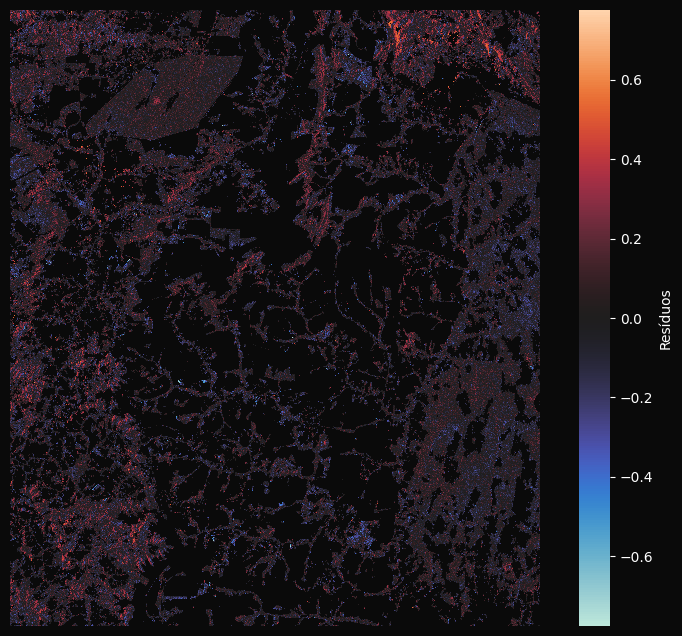

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn.linear_model import LinearRegression
import seaborn as sns

# Classe de interesse
classe = 3

# Garantir que a variável 'subset_classes' esteja carregada
subset_classes = globals()['subset_classes']

# Lista de referências
referencias = ["2/2_Out"]

# Lista para armazenar os resultados
results = []

# Função para calcular a distância perpendicular de um ponto a uma linha horizontal
def calcular_distancia_vertical(y, y_reg):
    return y - y_reg

# Loop através dos pares de bandas
for i in range(0, len(band_names), 3):
    # Carregar bandas
    b1 = globals()[band_names[i]]  # CO2
    b2 = globals()[band_names[i + 2]]  # VV

    # Calculando os percentis 1 e 99 para b1 e b2
    percentil_inicial = 1
    percentil_final = 99

    limite_inferior_b1 = np.percentile(b1, percentil_inicial)
    limite_superior_b1 = np.percentile(b1, percentil_final)

    limite_inferior_b2 = np.percentile(b2, percentil_inicial)
    limite_superior_b2 = np.percentile(b2, percentil_final)

    # Aplicando a expansão do histograma e remapeamento para b1 e b2
    b1_expandido = (b1 - limite_inferior_b1) / (limite_superior_b1 - limite_inferior_b1)
    b1_expandido = np.clip(b1_expandido, 0, 1)

    b2_expandido = (b2 - limite_inferior_b2) / (limite_superior_b2 - limite_inferior_b2)
    b2_expandido = np.clip(b2_expandido, 0, 1)

    # Criando uma máscara para a classe
    mask_class = (subset_classes == classe)

    # Aplicar máscara às bandas
    b1_classe = np.where(mask_class, b1_expandido, np.nan)
    b2_classe = np.where(mask_class, b2_expandido, np.nan)

    # Filtrar valores não-NaN
    valid_mask = ~np.isnan(b1_classe) & ~np.isnan(b2_classe)
    b1_valid = b1_classe[valid_mask]
    b2_valid = b2_classe[valid_mask]

    # Regressão Linear
    model = LinearRegression()
    b1_valid_reshape = b1_valid.reshape(-1, 1)  # Necessário para sklearn
    model.fit(b1_valid_reshape, b2_valid)
    b2_pred = model.predict(b1_valid_reshape)

    # Obter coeficientes da linha de regressão
    a = model.coef_[0]
    b = model.intercept_

    # Calcular o valor da linha de regressão para cada x
    b2_reg = a * b1_classe + b

    # Calcular a distância perpendicular para cada ponto
    distances = np.full(b1_classe.shape, np.nan)
    valid_indices = np.argwhere(~np.isnan(b1_classe))
    distances[valid_indices[:, 0], valid_indices[:, 1]] = calcular_distancia_vertical(b2_classe[valid_indices[:, 0], valid_indices[:, 1]], b2_reg[valid_indices[:, 0], valid_indices[:, 1]])

    # Ajustar a escala de cores
    dist_min = np.nanmin(distances)
    dist_max = np.nanmin(distances)*-1

    # Configurar a paleta de cores e o mapa de calor
    plt.figure(figsize=(10, 8))
    ax = sns.heatmap(distances, cmap='icefire', vmin=dist_min, vmax=dist_max, cbar_kws={'label': 'Resíduos'}, mask=np.isnan(distances), square=True, cbar=True)

    # Ajustar o fundo da figura e dos eixos
    plt.gcf().patch.set_facecolor('#0a0a0a')  # Cor de fundo da figura
    ax.set_facecolor('#0a0a0a')  # Cor de fundo dos eixos
    #plt.title(f'{referencias[i//2]}', color='white')
    plt.axis('off')  # Remover eixos

    # Ajustar a cor da barra de cores
    cbar = ax.collections[0].colorbar
    cbar.ax.yaxis.label.set_color('white')
    cbar.ax.yaxis.set_tick_params(color='white', labelcolor='white')

    # Salvar o mapa de calor
    # Substituir "/" por "_"
    safe_filename = f'heatmap_{referencias[i//2].replace("/", "_")}.png'
    plt.savefig(f'VV', dpi=300, bbox_inches='tight')

    #plt.show()

/usr/local/lib/python3.10/dist-packages/statsmodels/graphics/gofplots.py:1043: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b" (-> color=(0.0, 0.0, 1.0, 1)). The keyword argument will take precedence.
  ax.plot(x, y, fmt, **plot_style)


<Figure size 640x480 with 0 Axes>

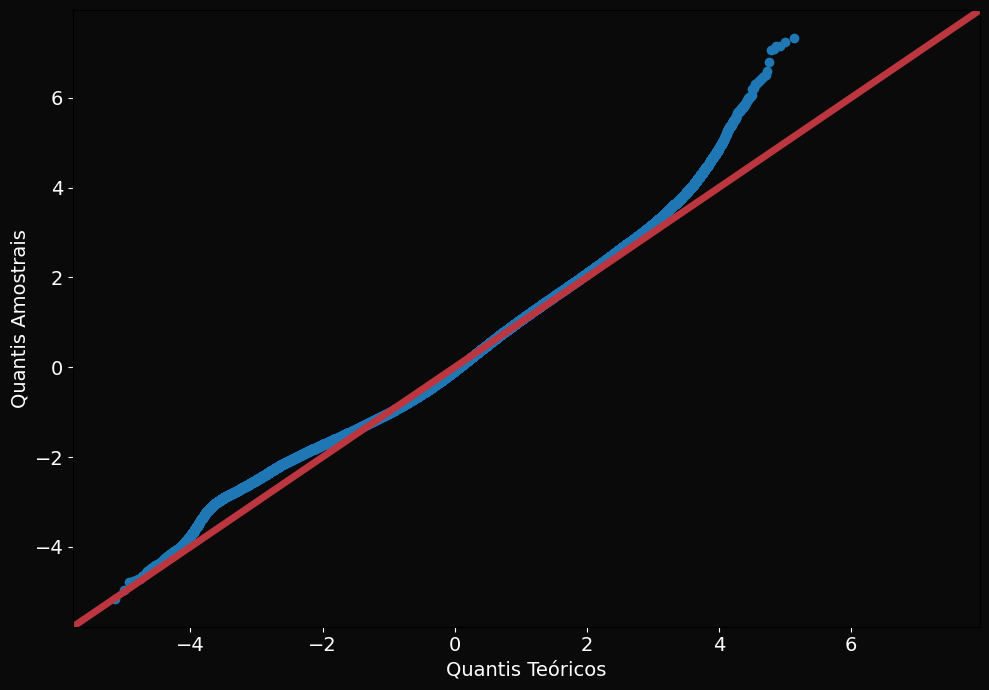

R² do ajuste à distribuição normal: 0.9909


In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn.linear_model import LinearRegression
import seaborn as sns
import statsmodels.api as sm
from scipy import stats

# Classe de interesse
classe = 1

# Garantir que a variável 'subset_classes' esteja carregada
subset_classes = globals()['subset_classes']

# Lista de referências
referencias = ["1/3_Jun", "2/3_Jun", "3/3_Jun", "1/2_Jul", "2/2_Jul", "1/3_Ago", "2/3_Ago", "3/3_Ago", "1/2_Set", "2/2_Set", "1/2_Out", "2/2_Out"]

# Função para calcular a distância perpendicular de um ponto a uma linha horizontal
def calcular_distancia_vertical(y, y_reg):
    return y - y_reg

# Inicializar array para acumular as distâncias e a máscara de NaNs
acumulador_distancias = np.zeros_like(globals()[band_names[0]])
acumulador_nan_mask = np.zeros_like(globals()[band_names[0]], dtype=bool)

# Loop através dos pares de bandas
for i in range(0, len(band_names), 2):
    # Carregar bandas
    b1 = globals()[band_names[i]]  # CO2
    b2 = globals()[band_names[i + 1]]  # VV

    # Calculando os percentis 1 e 99 para b1 e b2
    percentil_inicial = 1
    percentil_final = 99

    limite_inferior_b1 = np.percentile(b1, percentil_inicial)
    limite_superior_b1 = np.percentile(b1, percentil_final)

    limite_inferior_b2 = np.percentile(b2, percentil_inicial)
    limite_superior_b2 = np.percentile(b2, percentil_final)

    # Aplicando a expansão do histograma e remapeamento para b1 e b2
    b1_expandido = (b1 - limite_inferior_b1) / (limite_superior_b1 - limite_inferior_b1)
    b1_expandido = np.clip(b1_expandido, 0, 1)

    b2_expandido = (b2 - limite_inferior_b2) / (limite_superior_b2 - limite_inferior_b2)
    b2_expandido = np.clip(b2_expandido, 0, 1)

    # Criando uma máscara para a classe
    mask_class = (subset_classes == classe)

    # Aplicar máscara às bandas
    b1_classe = np.where(mask_class, b1_expandido, np.nan)
    b2_classe = np.where(mask_class, b2_expandido, np.nan)

    # Filtrar valores não-NaN
    valid_mask = ~np.isnan(b1_classe) & ~np.isnan(b2_classe)
    b1_valid = b1_classe[valid_mask]
    b2_valid = b2_classe[valid_mask]

    # Regressão Linear
    model = LinearRegression()
    b1_valid_reshape = b1_valid.reshape(-1, 1)  # Necessário para sklearn
    model.fit(b1_valid_reshape, b2_valid)
    b2_pred = model.predict(b1_valid_reshape)

    # Obter coeficientes da linha de regressão
    a = model.coef_[0]
    b = model.intercept_

    # Calcular o valor da linha de regressão para cada x
    b2_reg = a * b1_classe + b

    # Calcular a distância perpendicular para cada ponto
    distances = np.full(b1_classe.shape, np.nan)
    valid_indices = np.argwhere(~np.isnan(b1_classe))
    distances[valid_indices[:, 0], valid_indices[:, 1]] = calcular_distancia_vertical(b2_classe[valid_indices[:, 0], valid_indices[:, 1]], b2_reg[valid_indices[:, 0], valid_indices[:, 1]])

    # Acumular as distâncias
    acumulador_distancias += np.nan_to_num(distances)

    # Acumular a máscara de NaNs
    acumulador_nan_mask |= np.isnan(b1_classe)

# Filtrando os valores não-NaN do acumulador de distâncias
residuos = acumulador_distancias[~acumulador_nan_mask]

# Ajustar o fundo da figura
plt.gcf().patch.set_facecolor('#0a0a0a')

# Criar a figura e o eixo
fig, ax = plt.subplots(figsize=(10, 7))

# Ajustar fundo e eixos
fig.patch.set_facecolor('#0a0a0a')
ax.set_facecolor('#0a0a0a')

# QQ plot
sm.qqplot(residuos, line='45', fit=True, ax=ax, color='#3878CF')
ax.get_lines()[1].set_color('#BB363F')
ax.get_lines()[1].set_linewidth(5)  # Aumentar espessura da linha

# Ajustar o tamanho da fonte
font_size = 14  # Tamanho da fonte
ax.tick_params(axis='x', colors='white', labelsize=font_size)
ax.tick_params(axis='y', colors='white', labelsize=font_size)
ax.xaxis.label.set_color('white')
ax.yaxis.label.set_color('white')

# Adicionar ou alterar os rótulos dos eixos
ax.set_xlabel('Quantis Teóricos', fontsize=font_size)  # Rótulo do eixo x
ax.set_ylabel('Quantis Amostrais', fontsize=font_size)  # Rótulo do eixo y

ax.xaxis.label.set_fontsize(font_size)
ax.yaxis.label.set_fontsize(font_size)
ax.title.set_color('white')
ax.title.set_fontsize(font_size)

# Ajustar layout
plt.tight_layout()

# Salvar a figura
plt.savefig('/content/drive/MyDrive/Certa/Imagens/Novos/Cultivo_QQ_Data_VH.png', dpi=300, bbox_inches='tight')

# Exibir a figura
plt.show()

# Calcular o R²
# Ajustar os resíduos à distribuição normal
mean_residuos = np.mean(residuos)
std_residuos = np.std(residuos)
sorted_residuos = np.sort(residuos)

# Padrão de quantis da normal
norm_quantiles = stats.norm.ppf((np.arange(1, len(sorted_residuos)+1) - 0.5) / len(sorted_residuos), loc=mean_residuos, scale=std_residuos)

# Regressão Linear na distribuição normal
model_r2 = LinearRegression()
norm_quantiles_reshape = norm_quantiles.reshape(-1, 1)
model_r2.fit(norm_quantiles_reshape, sorted_residuos)
residuos_pred = model_r2.predict(norm_quantiles_reshape)

# Cálculo dos quadrados dos resíduos e totais
ss_res = np.sum((sorted_residuos - residuos_pred) ** 2)
ss_tot = np.sum((sorted_residuos - np.mean(sorted_residuos)) ** 2)

# Calcular o R²
r2 = 1 - (ss_res / ss_tot)
print(f'R² do ajuste à distribuição normal: {r2:.4f}')


12.378874
-14.178059 12.378874


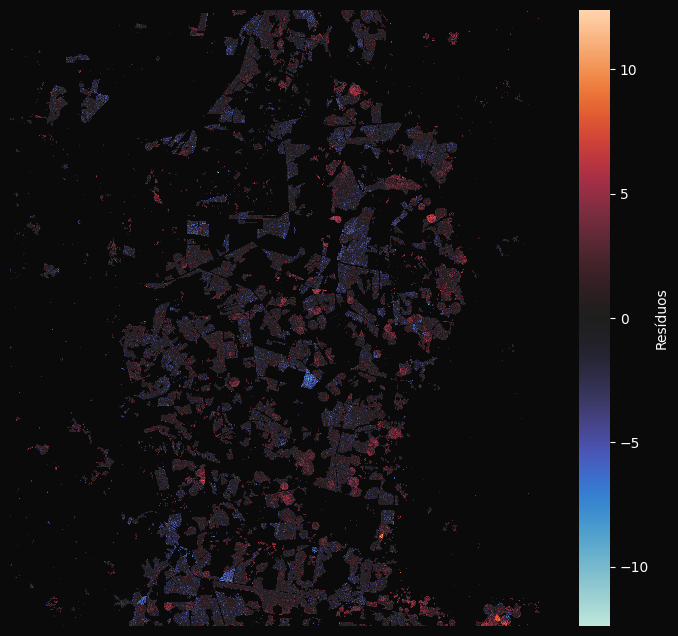

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn.linear_model import LinearRegression
import seaborn as sns

# Classe de interesse
classe = 3

# Garantir que a variável 'subset_classes' esteja carregada
subset_classes = globals()['subset_classes']

# Carregar a máscara de anomalias
anomalias = globals()['subset_anomalias']

# Lista de referências
referencias = ["1/3_Jun", "2/3_Jun", "3/3_Jun", "1/2_Jul", "2/2_Jul", "1/3_Ago", "2/3_Ago", "3/3_Ago", "1/2_Set", "2/2_Set", "1/2_Out", "2/2_Out"]

# Função para calcular a distância perpendicular de um ponto a uma linha horizontal
def calcular_distancia_vertical(y, y_reg):
    return y - y_reg

# Inicializar array para acumular as distâncias e a máscara de NaNs
acumulador_distancias = np.zeros_like(globals()[band_names[0]])
acumulador_nan_mask = np.zeros_like(globals()[band_names[0]], dtype=bool)

# Loop através dos pares de bandas
for i in range(0, len(band_names), 2):
    # Carregar bandas
    b1 = globals()[band_names[i]]  # CO2
    b2 = globals()[band_names[i + 1]]  # VV

    # Calculando os percentis 1 e 99 para b1 e b2
    percentil_inicial = 1
    percentil_final = 99

    limite_inferior_b1 = np.percentile(b1, percentil_inicial)
    limite_superior_b1 = np.percentile(b1, percentil_final)

    limite_inferior_b2 = np.percentile(b2, percentil_inicial)
    limite_superior_b2 = np.percentile(b2, percentil_final)

    # Aplicando a expansão do histograma e remapeamento para b1 e b2
    b1_expandido = (b1 - limite_inferior_b1) / (limite_superior_b1 - limite_inferior_b1)
    b1_expandido = np.clip(b1_expandido, 0, 1)

    b2_expandido = (b2 - limite_inferior_b2) / (limite_superior_b2 - limite_inferior_b2)
    b2_expandido = np.clip(b2_expandido, 0, 1)

    # Criando uma máscara para a classe
    mask_class = (subset_classes == classe)

    # Criar máscara para anomalias
    mask_anomalias = (anomalias < 3)

    # Combinar máscaras de classe e anomalias
    combined_mask = mask_class & mask_anomalias

    # Aplicar máscara às bandas
    b1_classe = np.where(combined_mask, b1, np.nan)
    b2_classe = np.where(combined_mask, b2, np.nan)

    # Filtrar valores não-NaN
    valid_mask = ~np.isnan(b1_classe) & ~np.isnan(b2_classe)
    b1_valid = b1_classe[valid_mask]
    b2_valid = b2_classe[valid_mask]

    # Regressão Linear
    model = LinearRegression()
    b1_valid_reshape = b1_valid.reshape(-1, 1)  # Necessário para sklearn
    model.fit(b1_valid_reshape, b2_valid)
    b2_pred = model.predict(b1_valid_reshape)

    # Obter coeficientes da linha de regressão
    a = model.coef_[0]
    b = model.intercept_

    # Calcular o valor da linha de regressão para cada x
    b2_reg = a * b1_classe + b

    # Calcular a distância perpendicular para cada ponto
    distances = np.full(b1_classe.shape, np.nan)
    valid_indices = np.argwhere(~np.isnan(b1_classe))
    distances[valid_indices[:, 0], valid_indices[:, 1]] = calcular_distancia_vertical(b2_classe[valid_indices[:, 0], valid_indices[:, 1]], b2_reg[valid_indices[:, 0], valid_indices[:, 1]])

    # Acumular as distâncias
    acumulador_distancias += np.nan_to_num(distances)

    # Acumular a máscara de NaNs
    acumulador_nan_mask |= np.isnan(b1_classe)


# Ajustar a escala de cores para o acumulador

if np.nanmin(acumulador_distancias) > np.nanmax(acumulador_distancias):
  dist_min = np.nanmin(acumulador_distancias)
  dist_max = np.nanmin(acumulador_distancias) * -1
  print(np.nanmin(acumulador_distancias))
else:
  dist_min = np.nanmax(acumulador_distancias) * -1
  dist_max = np.nanmax(acumulador_distancias)
  print(np.nanmax(acumulador_distancias))

print(np.nanmin(acumulador_distancias),np.nanmax(acumulador_distancias))

# Configurar a paleta de cores e o mapa de calor para o acumulador
plt.figure(figsize=(10, 8))
ax = sns.heatmap(acumulador_distancias, cmap='icefire', vmin=dist_min, vmax=dist_max, cbar_kws={'label': 'Resíduos'}, mask=acumulador_nan_mask, square=True, cbar=True)

# Ajustar o fundo da figura e dos eixos
plt.gcf().patch.set_facecolor('#0a0a0a')  # Cor de fundo da figura
ax.set_facecolor('#0a0a0a')  # Cor de fundo dos eixos
#plt.title('Somatório', color='white')
plt.axis('off')  # Remover eixos

# Ajustar a cor da barra de cores
cbar = ax.collections[0].colorbar
cbar.ax.yaxis.label.set_color('white')
cbar.ax.yaxis.set_tick_params(color='white', labelcolor='white')

# Salvar o mapa de calor acumulado
#plt.savefig('/content/drive/MyDrive/Certa/Imagens/Total_Acumulado_Cultivo_Tot_VH3.png', dpi=300, bbox_inches='tight')
plt.savefig('/content/Total_Acumulado_Cultivo_Tot_VH6.png', dpi=300, bbox_inches='tight')

plt.show()

/usr/local/lib/python3.10/dist-packages/statsmodels/graphics/gofplots.py:1043: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b" (-> color=(0.0, 0.0, 1.0, 1)). The keyword argument will take precedence.
  ax.plot(x, y, fmt, **plot_style)


<Figure size 640x480 with 0 Axes>

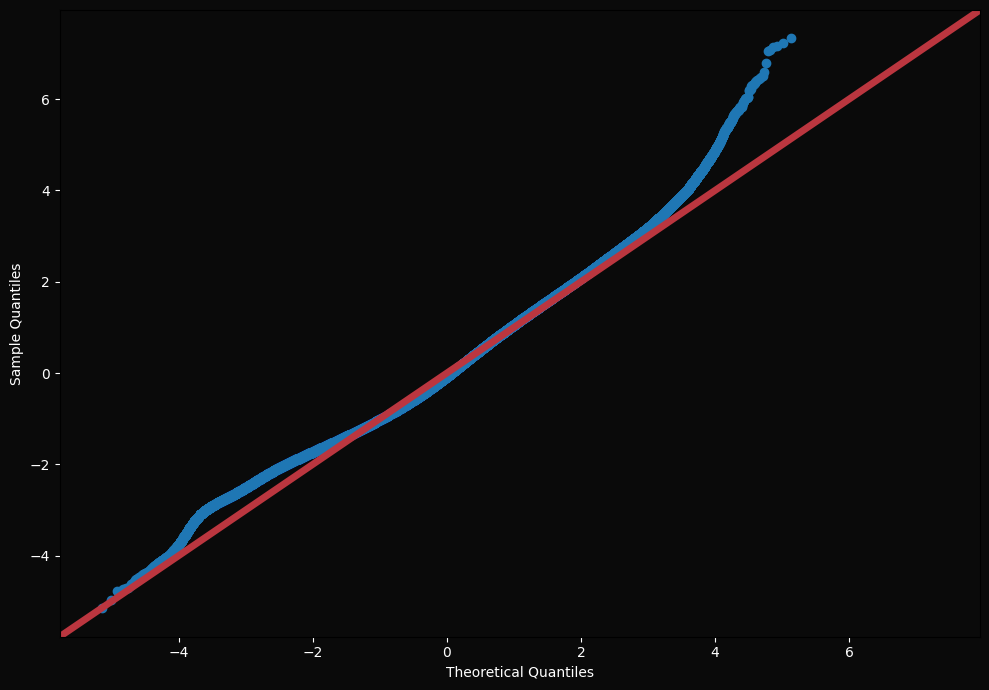

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn.linear_model import LinearRegression
import seaborn as sns
import statsmodels.api as sm
from scipy import stats


# Classe de interesse
classe = 1

# Garantir que a variável 'subset_classes' esteja carregada
subset_classes = globals()['subset_classes']

# Lista de referências
referencias = ["1/3_Jun", "2/3_Jun", "3/3_Jun", "1/2_Jul", "2/2_Jul", "1/3_Ago", "2/3_Ago", "3/3_Ago", "1/2_Set", "2/2_Set", "1/2_Out", "2/2_Out"]

# Função para calcular a distância perpendicular de um ponto a uma linha horizontal
def calcular_distancia_vertical(y, y_reg):
    return y - y_reg

# Inicializar array para acumular as distâncias e a máscara de NaNs
acumulador_distancias = np.zeros_like(globals()[band_names[0]])
acumulador_nan_mask = np.zeros_like(globals()[band_names[0]], dtype=bool)

# Loop através dos pares de bandas
for i in range(0, len(band_names), 2):
    # Carregar bandas
    b1 = globals()[band_names[i]]  # CO2
    b2 = globals()[band_names[i + 1]]  # VV

    # Calculando os percentis 1 e 99 para b1 e b2
    percentil_inicial = 1
    percentil_final = 99

    limite_inferior_b1 = np.percentile(b1, percentil_inicial)
    limite_superior_b1 = np.percentile(b1, percentil_final)

    limite_inferior_b2 = np.percentile(b2, percentil_inicial)
    limite_superior_b2 = np.percentile(b2, percentil_final)

    # Aplicando a expansão do histograma e remapeamento para b1 e b2
    b1_expandido = (b1 - limite_inferior_b1) / (limite_superior_b1 - limite_inferior_b1)
    b1_expandido = np.clip(b1_expandido, 0, 1)

    b2_expandido = (b2 - limite_inferior_b2) / (limite_superior_b2 - limite_inferior_b2)
    b2_expandido = np.clip(b2_expandido, 0, 1)

    # Criando uma máscara para a classe
    mask_class = (subset_classes == classe)

    # Aplicar máscara às bandas
    b1_classe = np.where(mask_class, b1_expandido, np.nan)
    b2_classe = np.where(mask_class, b2_expandido, np.nan)

    # Filtrar valores não-NaN
    valid_mask = ~np.isnan(b1_classe) & ~np.isnan(b2_classe)
    b1_valid = b1_classe[valid_mask]
    b2_valid = b2_classe[valid_mask]

    # Regressão Linear
    model = LinearRegression()
    b1_valid_reshape = b1_valid.reshape(-1, 1)  # Necessário para sklearn
    model.fit(b1_valid_reshape, b2_valid)
    b2_pred = model.predict(b1_valid_reshape)

    # Obter coeficientes da linha de regressão
    a = model.coef_[0]
    b = model.intercept_

    # Calcular o valor da linha de regressão para cada x
    b2_reg = a * b1_classe + b

    # Calcular a distância perpendicular para cada ponto
    distances = np.full(b1_classe.shape, np.nan)
    valid_indices = np.argwhere(~np.isnan(b1_classe))
    distances[valid_indices[:, 0], valid_indices[:, 1]] = calcular_distancia_vertical(b2_classe[valid_indices[:, 0], valid_indices[:, 1]], b2_reg[valid_indices[:, 0], valid_indices[:, 1]])

    # Acumular as distâncias
    acumulador_distancias += np.nan_to_num(distances)

    # Acumular a máscara de NaNs
    acumulador_nan_mask |= np.isnan(b1_classe)

# Filtrando os valores não-NaN do acumulador de distâncias
residuos = acumulador_distancias[~acumulador_nan_mask]

# Ajustar o fundo da figura
plt.gcf().patch.set_facecolor('#0a0a0a')

# Criar a figura e o eixo
fig, ax = plt.subplots(figsize=(10, 7))

# Ajustar fundo e eixos
fig.patch.set_facecolor('#0a0a0a')
ax.set_facecolor('#0a0a0a')

# QQ plot
sm.qqplot(residuos, line='45', fit=True, ax=ax, color='#3878CF')
ax.get_lines()[1].set_color('#BB363F')
ax.get_lines()[1].set_linewidth(5)  # Aumentar espessura da linha

# Ajustar as cores dos ticks e labels
ax.tick_params(axis='x', colors='white')
ax.tick_params(axis='y', colors='white')
ax.xaxis.label.set_color('white')
ax.yaxis.label.set_color('white')
ax.title.set_color('white')

# Ajustar layout
plt.tight_layout()

# Salvar a figura
plt.savefig('/content/Total_Acumulado_Cultivo_Tot_Residuos_QQ_VH.png', dpi=300, bbox_inches='tight')

# Exibir a figura
plt.show()


In [ ]:
from scipy import stats


# Calcular o R²
# Ajustar os resíduos à distribuição normal
mean_residuos = np.mean(residuos)
std_residuos = np.std(residuos)
sorted_residuos = np.sort(residuos)

# Padrão de quantis da normal
norm_quantiles = stats.norm.ppf((np.arange(1, len(sorted_residuos)+1) - 0.5) / len(sorted_residuos), loc=mean_residuos, scale=std_residuos)

# Regressão Linear na distribuição normal
model_r2 = LinearRegression()
norm_quantiles_reshape = norm_quantiles.reshape(-1, 1)
model_r2.fit(norm_quantiles_reshape, sorted_residuos)
residuos_pred = model_r2.predict(norm_quantiles_reshape)

# Cálculo dos quadrados dos resíduos e totais
ss_res = np.sum((sorted_residuos - residuos_pred) ** 2)
ss_tot = np.sum((sorted_residuos - np.mean(sorted_residuos)) ** 2)

# Calcular o R²
r2 = 1 - (ss_res / ss_tot)
print(f'R² do ajuste à distribuição normal: {r2:.4f}')

R² do ajuste à distribuição normal: 0.9871


# **Equação do Cultivo (Segundo Grau)**

Equação do modelo: CO2 = 0.6840390886297865 + 0.0238022321617765 * VH + 0.0287174734141125 * VV + 0.0001288708745258 * VH^2 + 0.0009111334322703 * VH VV + -0.0000100862928980 * VV^2
R² = 0.776
R² Ajustado = 0.776
MAE = 0.024
RMSE = 0.033


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but PolynomialFeatures was fitted with feature names
  warnings.warn(


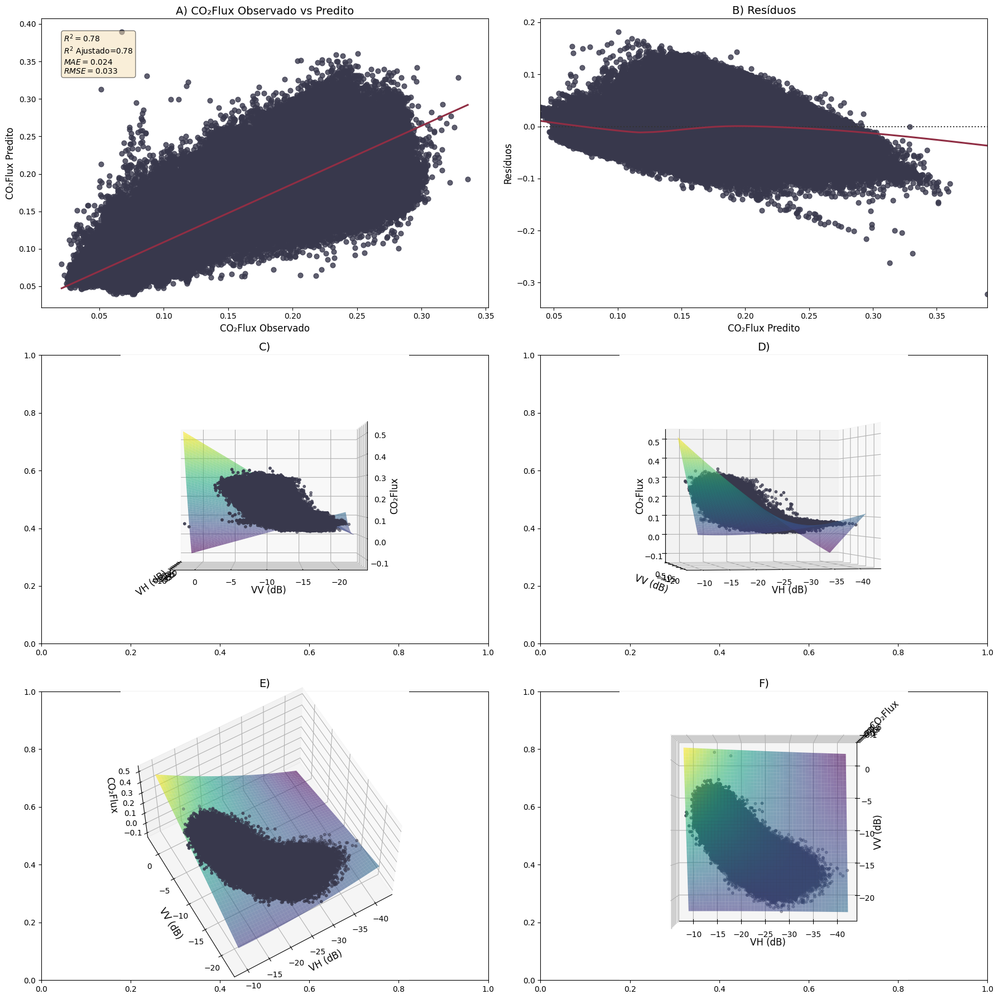

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Carregar os dados das classes 3 e 8
bacon_class_3 = pd.read_excel('/content/drive/MyDrive/dados_classes_3_e_8_T.xlsx', sheet_name="Classe_3")
bacon_class_8 = pd.read_excel('/content/drive/MyDrive/dados_classes_3_e_8_T.xlsx', sheet_name="Classe_8")
bacon_class_7 = pd.read_excel('/content/drive/MyDrive/dados_classes_3_e_8_T.xlsx', sheet_name="Classe_7")


# Concatenar os dados
bacon = pd.concat([bacon_class_3, bacon_class_8,bacon_class_7], ignore_index=True)

# Separar as variáveis independentes (VH, VV) e a variável dependente (CO2)
X = bacon[['VH', 'VV']]
y = bacon['CO2']

# Criar a transformação polinomial de ordem 3
poly = PolynomialFeatures(degree=2)
X_poly = poly.fit_transform(X)

# Ajustar o modelo de regressão linear polinomial
model = LinearRegression()
model.fit(X_poly, y)

# Predições
y_pred = model.predict(X_poly)

# Coeficientes do modelo
coefficients = model.coef_
intercept = model.intercept_

# Calcular o R²
r2 = r2_score(y, y_pred)

# Calcular o R² ajustado
n = len(y)
k = X_poly.shape[1] - 1
r2_adjusted = 1 - ((1 - r2) * (n - 1)) / (n - k - 1)

# Calcular MAE e RMSE
mae = mean_absolute_error(y, y_pred)
rmse = np.sqrt(mean_squared_error(y, y_pred))

# Exibir a equação do modelo e as métricas
equation_terms = ['{:.16f}'.format(intercept)]
features = poly.get_feature_names_out(['VH', 'VV'])
for coef, term in zip(coefficients[1:], features[1:]):
    equation_terms.append(f'{coef:.16f} * {term}')
equation = ' + '.join(equation_terms)

print(f'Equação do modelo: CO2 = {equation}')
print(f'R² = {r2:.3f}')
print(f'R² Ajustado = {r2_adjusted:.3f}')
print(f'MAE = {mae:.3f}')
print(f'RMSE = {rmse:.3f}')

#---------------------------------------

# Exibir o resumo do modelo polinomial
print("Resumo do Modelo Polinomial")
print(model_sm.summary())


#---------------------------------------

# Visualização
fig, axs = plt.subplots(3, 2, figsize=(18, 18))

# Configurações de fonte
font_size_large = 14
font_size_medium = 12
font_size_small = 10

# Gráfico de regressão linear para CO2 (predito) vs CO2 (observado)
sns.regplot(x=y, y=y_pred, scatter_kws={'color': '#38384c', 's': 40,'alpha': 0.8}, line_kws={'color': '#902e44'}, ax=axs[0, 0])
axs[0, 0].set_title('A) CO₂Flux Observado vs Predito', fontsize=font_size_large)
axs[0, 0].set_xlabel('CO₂Flux Observado', fontsize=font_size_medium)
axs[0, 0].set_ylabel('CO₂Flux Predito', fontsize=font_size_medium)
axs[0, 0].tick_params(axis='both', which='major', labelsize=font_size_small)

# Adicionar caixa de texto com métricas e equação
textstr = '\n'.join((
    #f'Equação: {equation}',
    f'$R^2={r2:.2f}$',
    f'$R^2$ Ajustado={r2_adjusted:.2f}',
    f'$MAE={mae:.3f}$',
    f'$RMSE={rmse:.3f}$',
))
props = dict(boxstyle='round', facecolor='wheat', alpha=0.5)
axs[0, 0].text(0.05, 0.95, textstr, transform=axs[0, 0].transAxes, fontsize=font_size_small,
               verticalalignment='top', bbox=props)

# Plotar o gráfico de resíduos com lowess
sns.residplot(x=y_pred, y=y, lowess=True, line_kws=dict(color="#902e44"), ax=axs[0, 1], scatter_kws={'s': 40,'color': '#38384c', 'alpha': 0.8})
axs[0, 1].set_title('B) Resíduos', fontsize=font_size_large)
axs[0, 1].set_xlabel('CO₂Flux Predito', fontsize=font_size_medium)
axs[0, 1].set_ylabel('Resíduos', fontsize=font_size_medium)
axs[0, 1].tick_params(axis='both', which='major', labelsize=font_size_small)

# Criar uma grade de valores para VH e VV
vh_range = np.linspace(X['VH'].min(), X['VH'].max(), 100)
vv_range = np.linspace(X['VV'].min(), X['VV'].max(), 100)
VH, VV = np.meshgrid(vh_range, vv_range)
grid = np.c_[VH.ravel(), VV.ravel()]
grid_poly = poly.transform(grid)
Z = model.predict(grid_poly)
Z = Z.reshape(VH.shape)

rampa = "viridis"
scatter_color = '#38384c'

# Visualizações 3D
ax1 = fig.add_subplot(3, 2, 3, projection='3d')
ax1.plot_surface(VH, VV, Z, cmap=rampa, alpha=0.6, edgecolor='none')
ax1.scatter(X['VH'], X['VV'], y, color=scatter_color, s=10)
ax1.view_init(elev=0, azim=0)
ax1.set_xlabel('VH (dB)', fontsize=font_size_medium)
ax1.set_ylabel('VV (dB)', fontsize=font_size_medium)
ax1.set_zlabel('CO₂Flux', fontsize=font_size_medium)
ax1.set_title('C)', fontsize=font_size_large)
ax1.tick_params(axis='both', which='major', labelsize=font_size_small)

ax2 = fig.add_subplot(3, 2, 4, projection='3d')
ax2.plot_surface(VH, VV, Z, cmap=rampa, alpha=0.6, edgecolor='none')
ax2.scatter(X['VH'], X['VV'], y, color=scatter_color, s=10)
ax2.view_init(elev=0, azim=80)
ax2.set_xlabel('VH (dB)', fontsize=font_size_medium)
ax2.set_ylabel('VV (dB)', fontsize=font_size_medium)
ax2.set_zlabel('CO₂Flux', fontsize=font_size_medium)
ax2.set_title('D)', fontsize=font_size_large)
ax2.tick_params(axis='both', which='major', labelsize=font_size_small)


ax3 = fig.add_subplot(3, 2, 5, projection='3d')
ax3.plot_surface(VH, VV, Z, cmap=rampa, alpha=0.6, edgecolor='none')
ax3.scatter(X['VH'], X['VV'], y, color=scatter_color, s=10)
ax3.view_init(elev=60, azim=60)
ax3.set_xlabel('VH (dB)', fontsize=font_size_medium)
ax3.set_ylabel('VV (dB)', fontsize=font_size_medium)
ax3.set_zlabel('CO₂Flux', fontsize=font_size_medium)
ax3.set_title('E)', fontsize=font_size_large)
ax3.tick_params(axis='both', which='major', labelsize=font_size_small)


ax4 = fig.add_subplot(3, 2, 6, projection='3d')
ax4.plot_surface(VH, VV, Z, cmap=rampa, alpha=0.6, edgecolor='none')
ax4.scatter(X['VH'], X['VV'], y, color=scatter_color, s=10)
ax4.view_init(elev=90, azim=90)
ax4.set_xlabel('VH (dB)', fontsize=font_size_medium)
ax4.set_ylabel('VV (dB)', fontsize=font_size_medium)
ax4.set_zlabel('CO₂Flux', fontsize=font_size_medium)
ax4.set_title('F)', fontsize=font_size_large)
ax4.tick_params(axis='both', which='major', labelsize=font_size_small)


# Inverter o eixo VV
for ax in [ax1, ax2, ax3, ax4]:
    ax.set_ylim(ax.get_ylim()[::-1])

plt.tight_layout()
plt.savefig("tnt",dpi=300)
plt.show()




In [ ]:
import pandas as pd
from scipy.stats import spearmanr, norm, pearsonr
import numpy as np

# Carregar os dados
bacon_class_3 = pd.read_excel('/content/drive/MyDrive/dados_classes_3_e_8_T.xlsx', sheet_name="Classe_3")
bacon_class_8 = pd.read_excel('/content/drive/MyDrive/dados_classes_3_e_8_T.xlsx', sheet_name="Classe_7")
bacon_class_7 = pd.read_excel('/content/drive/MyDrive/dados_classes_3_e_8_T.xlsx', sheet_name="Classe_8")
bacon_class_18 = pd.read_excel('/content/drive/MyDrive/dados_classes_3_e_8_T.xlsx', sheet_name="Classe_18")

# Função para calcular a correlação de Spearman e valor Z de Fisher
def calculate_spearman(df, column1, column2):
    corr, p_value = pearsonr(df[column1], df[column2])
    n = len(df)
    df_value = n - 2  # Graus de liberdade
    z_value = 0.5 * (np.log(1 + corr) - np.log(1 - corr)) * np.sqrt(n - 3)
    return {'correlation': corr, 'p_value': p_value, 'df': df_value, 'z_value': z_value}

# Lista de DataFrames
dfs = [bacon_class_3, bacon_class_8, bacon_class_7, bacon_class_18]

# Calcular correlações
results = []
for i, df in enumerate(dfs, start=1):
    result = {
        'Classe': f'Classe_{i*3}',
        'CO2-VV': calculate_spearman(df, 'CO2', 'VV'),
        'CO2-VH': calculate_spearman(df, 'CO2', 'VH')
    }
    results.append(result)

# Transformar em DataFrame para visualização
correlation_results = []
for result in results:
    correlation_results.append({
        'Classe': result['Classe'],
        'Variable': 'CO2-VV',
        'Correlation': result['CO2-VV']['correlation'],
        'Z-value': result['CO2-VV']['z_value'],
        'P-value': result['CO2-VV']['p_value'],
        'DF': result['CO2-VV']['df'],
    })
    correlation_results.append({
        'Classe': result['Classe'],
        'Variable': 'CO2-VH',
        'Correlation': result['CO2-VH']['correlation'],
        'Z-value': result['CO2-VH']['z_value'],
        'P-value': result['CO2-VH']['p_value'],
        'DF': result['CO2-VH']['df'],
    })

# Criar DataFrame de resultados
correlation_df = pd.DataFrame(correlation_results)
correlation_df


,Classe,Variable,Correlation,Z-value,P-value,DF
0,Classe_3,CO2-VV,0.860959,503.339609,0.000000e+00,150598
1,Classe_3,CO2-VH,0.851452,489.513236,0.000000e+00,150598
2,Classe_6,CO2-VV,0.504101,221.619497,0.000000e+00,159574
3,Classe_6,CO2-VH,0.606202,280.782227,0.000000e+00,159574
4,Classe_9,CO2-VV,0.695376,399.725162,0.000000e+00,216898
5,Classe_9,CO2-VH,0.819303,537.766864,0.000000e+00,216898
6,Classe_12,CO2-VV,0.089814,19.303379,6.459386e-83,45946
7,Classe_12,CO2-VH,0.112936,24.311346,2.790307e-130,45946


# **Equação da Vegetação**

## **Dados**

In [ ]:
import pandas as pd
import numpy as np

clima = pd.read_excel('/content/drive/MyDrive/INMET_AGUAS EMENDADAS.xlsx', sheet_name='Planilha2')

In [ ]:
# Renomear a coluna 'Referencia' do df p/ 'Period'

clima = clima.rename(columns={'Referencia': 'Period'})

In [ ]:
# Calculate the norm of the vector formed by the two columns
clima['Norma_Vetor'] = np.sqrt(clima['TEMPERATURA MÁXIMA NA HORA ANT. (AUT) (°C)']**2 + clima['UMIDADE REL. MIN. NA HORA ANT. (AUT) (%)']**2)


In [ ]:
import math

# Calcular o ângulo em radianos
clima['Angulo'] = np.arctan2(clima['UMIDADE REL. MIN. NA HORA ANT. (AUT) (%)'], clima['TEMPERATURA MÁXIMA NA HORA ANT. (AUT) (°C)'])

# converter
clima['Angulo_Graus'] = np.degrees(clima['Angulo'])


In [ ]:
clima

,Period,"PRECIPITAÇÃO TOTAL, HORÁRIO (mm)",RADIACAO GLOBAL (Kj/m²),"PRESSAO ATMOSFERICA AO NIVEL DA ESTACAO, HORARIA (mB)",PRESSÃO ATMOSFERICA MAX.NA HORA ANT. (AUT) (mB),PRESSÃO ATMOSFERICA MIN. NA HORA ANT. (AUT) (mB),"TEMPERATURA DO AR - BULBO SECO, HORARIA (°C)",TEMPERATURA DO PONTO DE ORVALHO (°C),TEMPERATURA MÁXIMA NA HORA ANT. (AUT) (°C),TEMPERATURA MÍNIMA NA HORA ANT. (AUT) (°C),...,TEMPERATURA ORVALHO MIN. NA HORA ANT. (AUT) (°C),UMIDADE REL. MAX. NA HORA ANT. (AUT) (%),UMIDADE REL. MIN. NA HORA ANT. (AUT) (%),"UMIDADE RELATIVA DO AR, HORARIA (%)","VENTO, DIREÇÃO HORARIA (gr) (° (gr))","VENTO, RAJADA MAXIMA (m/s)","VENTO, VELOCIDADE HORARIA (m/s)",Norma_Vetor,Angulo,Angulo_Graus
0,1/3_Jun,0.000000,18258.966667,901.459028,901.658333,901.271528,18.971528,10.359028,19.929861,18.044444,...,9.807639,65.402778,58.409722,61.909722,121.097222,4.847222,1.943750,61.716246,1.241975,71.159951
1,2/3_Jun,0.000000,17011.766667,902.466667,902.676389,902.252778,20.594444,12.843056,21.343056,19.850000,...,12.484722,66.777778,60.763889,63.555556,130.763889,5.276389,2.026389,64.403231,1.233012,70.646393
2,3/3_Jun,0.000000,19104.100000,902.618750,902.820833,902.377083,18.893750,9.639583,19.743750,18.093750,...,9.212500,60.270833,54.125000,57.437500,83.104167,6.037500,2.447917,57.613638,1.221015,69.959011
3,1/2_Jul,0.000000,19251.500000,904.981250,905.193750,904.760417,19.191667,10.052083,19.993750,18.364583,...,9.539583,61.416667,55.812500,58.479167,116.750000,5.622917,2.293750,59.285624,1.226808,70.290918
4,2/2_Jul,0.000000,18882.325000,903.409375,903.628125,903.202083,19.250000,9.297917,20.127083,18.275000,...,8.763542,59.000000,52.385417,55.541667,101.781250,6.368750,2.537500,56.118904,1.203974,68.982647
5,1/3_Ago,0.000000,17852.100000,901.258333,901.454167,901.037500,21.266667,8.795833,22.270833,20.437500,...,8.287500,50.250000,44.333333,47.416667,97.291667,5.212500,1.933333,49.612846,1.105271,63.327351
6,2/3_Ago,0.050000,20762.675000,901.819792,902.061458,901.615625,20.664583,7.635417,21.631250,19.648958,...,7.118750,50.375000,44.072917,47.218750,87.000000,4.963542,1.827083,49.095142,1.114531,63.857921
7,3/3_Ago,0.000000,21255.500000,902.412500,902.654167,902.204167,21.672917,7.429167,22.562500,20.933333,...,7.031250,43.416667,39.041667,41.270833,79.833333,6.575000,2.479167,45.092329,1.046779,59.976030
8,1/2_Set,0.000000,19660.100000,903.810417,904.110417,903.558333,21.266667,10.389583,22.081250,20.631250,...,9.916667,53.750000,48.583333,51.666667,68.416667,6.750000,2.754167,53.365924,1.144204,65.558081
9,2/2_Set,0.600000,17166.675000,899.391667,899.695833,899.111458,23.911458,13.455208,24.794792,23.134375,...,12.813542,60.020833,52.333333,56.354167,138.718750,5.339583,1.952083,57.909926,1.128339,64.649069


In [ ]:
import pandas as pd
import numpy as np

# Carregar os dados
bacon_class_11 = pd.read_excel('/content/drive/MyDrive/dados_classes_3_e_8_T.xlsx', sheet_name="Classe_11")
bacon_class_27 = pd.read_excel('/content/drive/MyDrive/dados_classes_3_e_8_T.xlsx', sheet_name="Classe_27")

# Lista de DataFrames
lista = [bacon_class_11,bacon_class_27]

# Rótulos de período
labels = [
    '1/3_Jun', '2/3_Jun', '3/3_Jun',
    '1/2_Jul', '2/2_Jul',
    '1/3_Ago', '2/3_Ago', '3/3_Ago',
    '1/2_Set', '2/2_Set',
    '1/2_Out', '2/2_Out'
]

# Adicionar rótulos de período e identificadores de origem
for idx, df in enumerate(lista):
    # Dividir os dados em 12 partes iguais e adicionar os rótulos de período
    num_periods = len(labels)
    period_size = len(df) // num_periods
    periods = np.repeat(labels, period_size)

    # Certifique-se de que o comprimento dos rótulos de período corresponda ao comprimento do DataFrame
    periods = np.resize(periods, len(df))

    # Adicionar coluna de período e id
    df['Period'] = periods
    df['id'] = 11 if idx == 0 else 27

    df.reset_index(drop=True, inplace=True)  # Resetar o índice após a ordenação

# Concatenar todos os DataFrames
bacon = pd.concat(lista, ignore_index=True)

# Mostrar as primeiras linhas para verificar
bacon


,CO2,VH,VV,Period,id
0,0.042057,-18.173412,-11.343255,1/3_Jun,11
1,0.048968,-18.255844,-11.683288,1/3_Jun,11
2,0.037495,-18.493000,-11.671894,1/3_Jun,11
3,0.043152,-19.505611,-11.648482,1/3_Jun,11
4,0.059913,-19.473948,-11.269349,1/3_Jun,11
...,...,...,...,...,...
34675,0.212341,-15.046129,-9.295728,2/2_Out,27
34676,0.215626,-16.996691,-9.182789,2/2_Out,27
34677,0.213969,-16.948772,-9.313481,2/2_Out,27
34678,0.214292,-15.679307,-9.170252,2/2_Out,27


In [ ]:
# Realizar o merge dos DataFrames
bacon = bacon.merge(clima, on='Period', how='left')
bacon.columns

Index(['CO2', 'VH', 'VV', 'Period', 'id', 'PRECIPITAÇÃO TOTAL, HORÁRIO (mm)',
       'RADIACAO GLOBAL (Kj/m²)',
       'PRESSAO ATMOSFERICA AO NIVEL DA ESTACAO, HORARIA (mB)',
       'PRESSÃO ATMOSFERICA MAX.NA HORA ANT. (AUT) (mB)',
       'PRESSÃO ATMOSFERICA MIN. NA HORA ANT. (AUT) (mB)',
       'TEMPERATURA DO AR - BULBO SECO, HORARIA (°C)',
       'TEMPERATURA DO PONTO DE ORVALHO (°C)',
       'TEMPERATURA MÁXIMA NA HORA ANT. (AUT) (°C)',
       'TEMPERATURA MÍNIMA NA HORA ANT. (AUT) (°C)',
       'TEMPERATURA ORVALHO MAX. NA HORA ANT. (AUT) (°C)',
       'TEMPERATURA ORVALHO MIN. NA HORA ANT. (AUT) (°C)',
       'UMIDADE REL. MAX. NA HORA ANT. (AUT) (%)',
       'UMIDADE REL. MIN. NA HORA ANT. (AUT) (%)',
       'UMIDADE RELATIVA DO AR, HORARIA (%)',
       'VENTO, DIREÇÃO HORARIA (gr) (° (gr))', 'VENTO, RAJADA MAXIMA (m/s)',
       'VENTO, VELOCIDADE HORARIA (m/s)', 'Norma_Vetor', 'Angulo',
       'Angulo_Graus'],
      dtype='object')

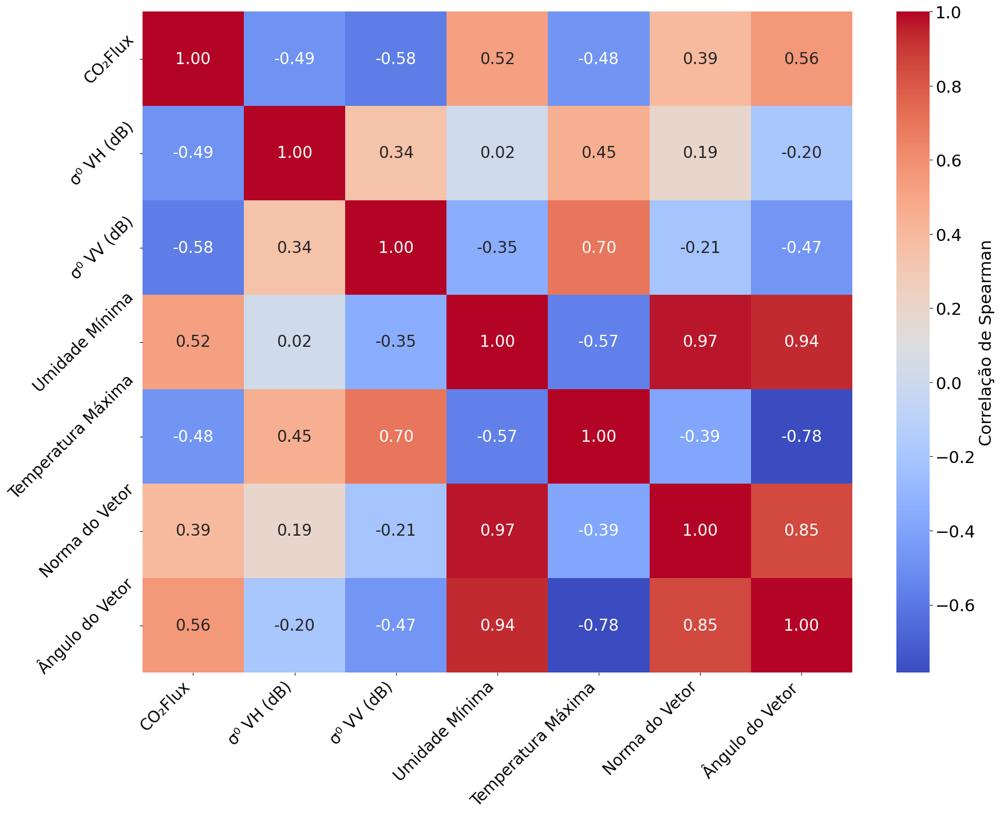

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

bacon_11 = bacon[bacon['id'] == 11]

# Selecionar as colunas para a correlação
cols_for_corr = ['CO2', 'VH', 'VV', 'UMIDADE REL. MIN. NA HORA ANT. (AUT) (%)',
                 'TEMPERATURA MÁXIMA NA HORA ANT. (AUT) (°C)', 'Norma_Vetor', 'Angulo']

# Calcular a correlação de Spearman com a média por período
corr_matrix = bacon_11.groupby('Period')[cols_for_corr].mean().corr(method='spearman')

# Renomear as variáveis
corr_matrix.rename(index={'CO2': 'CO₂Flux',
                          'VH': 'σ⁰ VH (dB)',
                          'VV': 'σ⁰ VV (dB)',
                          'UMIDADE REL. MIN. NA HORA ANT. (AUT) (%)': 'Umidade Mínima',
                          'TEMPERATURA MÁXIMA NA HORA ANT. (AUT) (°C)': 'Temperatura Máxima',
                          'Norma_Vetor': 'Norma do Vetor',
                          'Angulo': 'Ângulo do Vetor'},
                   columns={'CO2': 'CO₂Flux',
                            'VH': 'σ⁰ VH (dB)',
                            'VV': 'σ⁰ VV (dB)',
                            'UMIDADE REL. MIN. NA HORA ANT. (AUT) (%)': 'Umidade Mínima',
                            'TEMPERATURA MÁXIMA NA HORA ANT. (AUT) (°C)': 'Temperatura Máxima',
                            'Norma_Vetor': 'Norma do Vetor',
                            'Angulo': 'Ângulo do Vetor'}, inplace=True)

# Criar o mapa de calor
plt.figure(figsize=(20, 15))

#sns.set(font_scale=1.5)  # Aumenta o tamanho geral da fonte
sns.heatmap(corr_matrix,
            annot=True,
            cmap='coolwarm',
            fmt=".2f",
            annot_kws={"size": 20},  # Aumenta o tamanho da fonte das anotações
            cbar_kws={'label': 'Correlação de Spearman'})

plt.xticks(rotation=45, ha='right', fontsize=20)
plt.yticks(fontsize=20, rotation=45)
plt.savefig("MC",dpi=300,bbox_inches='tight')
plt.show()


## **Gráficos**

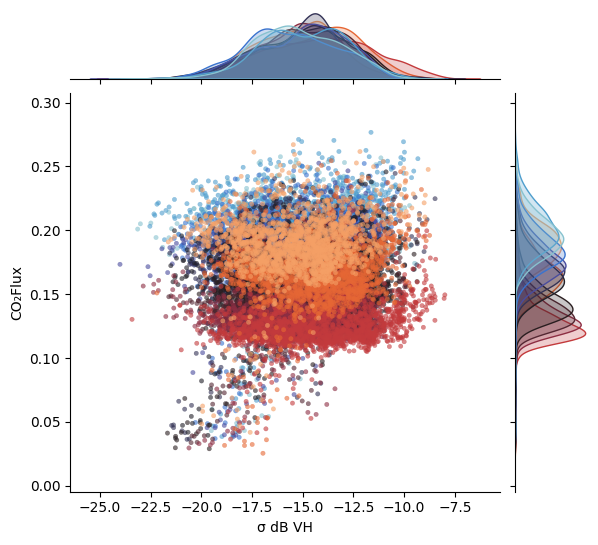

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Criação do jointplot
g = sns.jointplot(
    data=bacon_11,
    x="VH",
    y="CO2",
    hue="Period",
    kind="scatter",
    palette='icefire',
    s=10,  # tamanho dos pontos
    alpha=0.6,  # transparência dos pontos
    edgecolor=None,  # sem borda nos pontos
    marker='o',  # tipo de marcador
)

# Remover a legenda gráfica
if g.ax_joint.get_legend() is not None:
    g.ax_joint.get_legend().remove()

# Ajuste final do gráfico
plt.subplots_adjust(top=0.9)
g.set_axis_labels("σ dB VH", "CO₂Flux")# Mostrar o gráfico

plt.savefig("11_j",dpi=300)
plt.show()



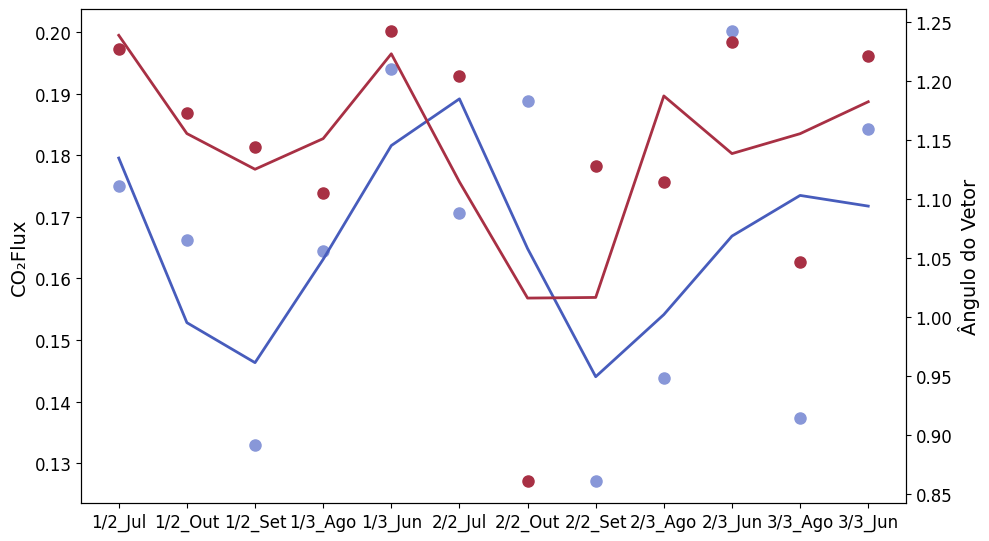

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.signal import savgol_filter

#sns.set(font_scale=1.2)  # Aumenta o tamanho geral da fonte

# Agrupa os dados por 'Period' e calcula a média das colunas desejadas
media_por_periodo = bacon_11.groupby('Period').agg({'CO2': 'mean', 'Angulo': 'mean'})

# Extração dos valores necessários para o gráfico de evolução
referencias = media_por_periodo.index.tolist()
mean_CO2 = media_por_periodo['CO2'].values
mean_NAP = media_por_periodo['Angulo'].values

# Suavização dos dados
smooth_CO2 = savgol_filter(mean_CO2, 5, 2)
smooth_NAP = savgol_filter(mean_NAP, 5, 2)

# Criação da figura e do subplot
fig, ax_evol = plt.subplots(figsize=(10, 6))

# Gráfico de evolução de CO2
ax_evol.plot(referencias, mean_CO2, 'o', label='CO2Flux', color='#8897d8', markersize=8)
ax_evol.plot(referencias, smooth_CO2, color='#475cbc', linestyle='-', linewidth=2)
ax_evol.set_ylabel('CO₂Flux', color='black', fontsize=14)
ax_evol.tick_params(axis='y', labelcolor='black', labelsize=12)

# Remover grids do eixo principal
ax_evol.grid(False)

# Gráfico de evolução de Normalized Accumulated Precipitation
ax_evol_nap = ax_evol.twinx()
ax_evol_nap.plot(referencias, mean_NAP, 'o', label='Ângulo do Vetor', color='#a83044', markersize=8)
ax_evol_nap.plot(referencias, smooth_NAP, color='#a83044', linestyle='-', linewidth=2)
ax_evol_nap.set_ylabel('Ângulo do Vetor', color='black', fontsize=14)
ax_evol_nap.tick_params(axis='y', labelcolor='black', labelsize=12)
ax_evol.tick_params(axis='x', labelsize=12)

# Remover grids do eixo secundário
ax_evol_nap.grid(False)

# Rotacionar os ticks do eixo x em 45 graus
plt.xticks(rotation=45)

# Ajustar o layout
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.savefig('11_ocilação', dpi=300)
plt.show()


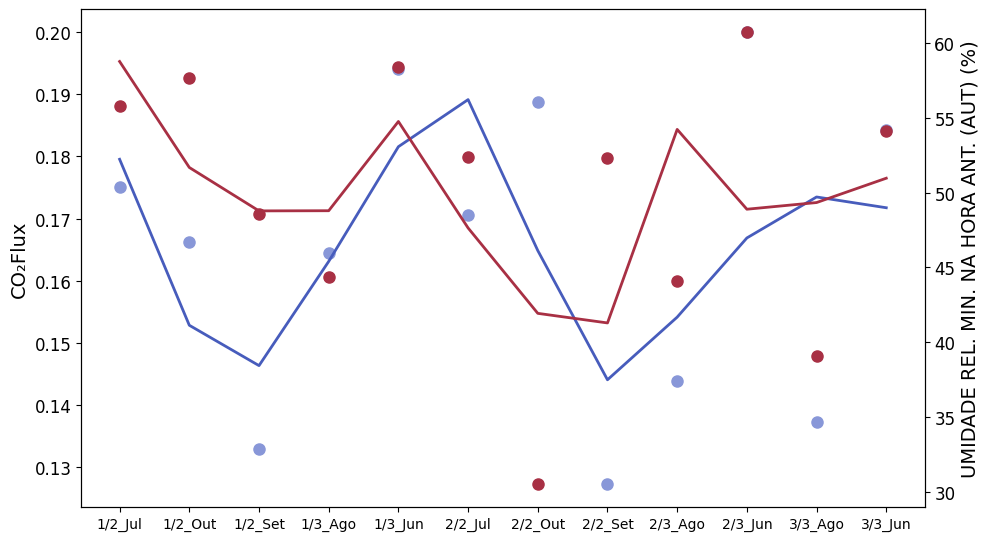

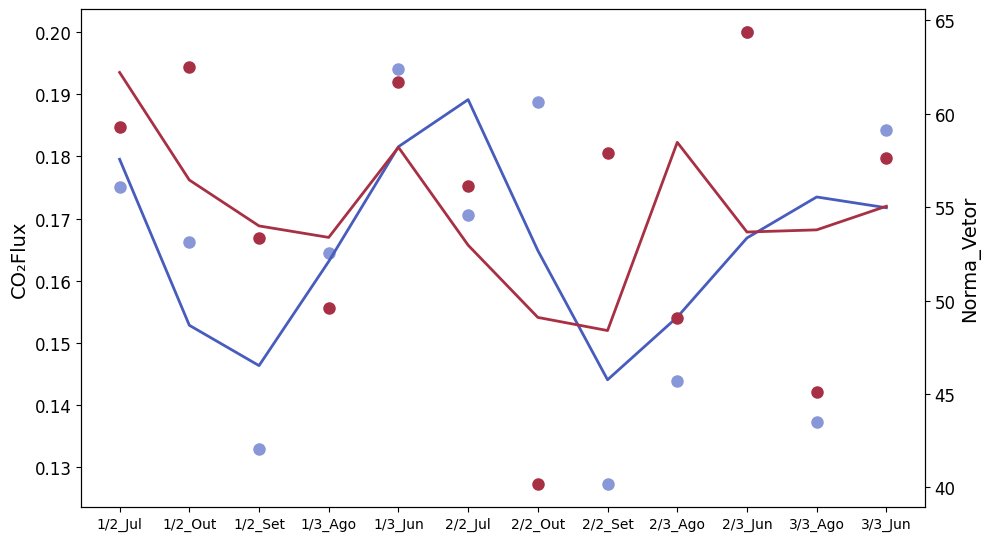

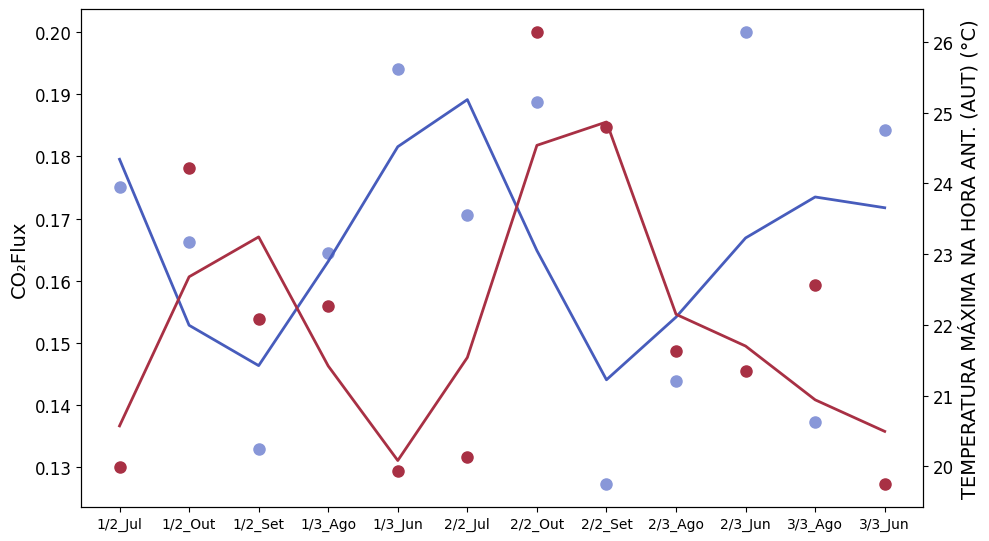

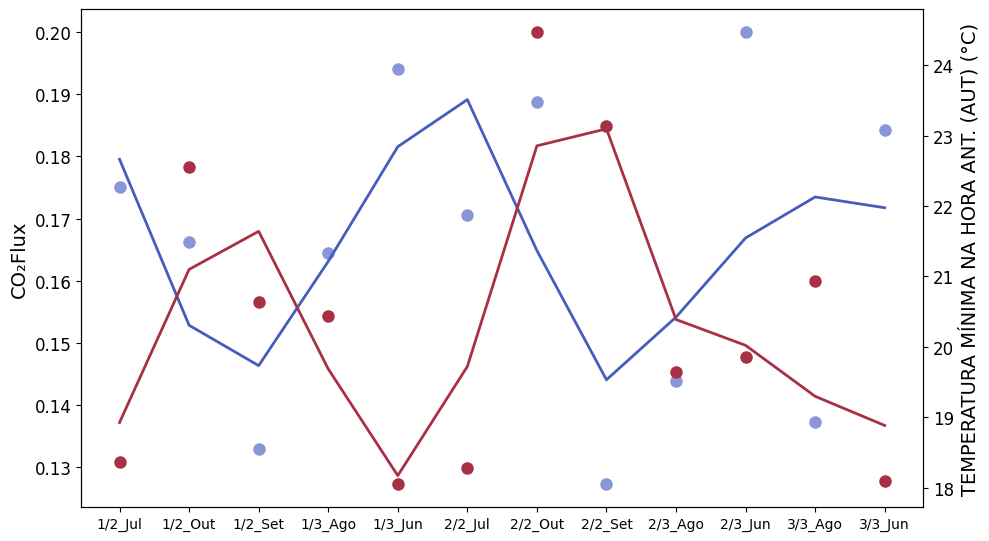

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.signal import savgol_filter

# Agrupa os dados por 'Period' e calcula a média das colunas desejadas
media_por_periodo = bacon.groupby('Period').agg({
    'CO2': 'mean',
    'UMIDADE REL. MIN. NA HORA ANT. (AUT) (%)': 'mean',
    'Norma_Vetor': 'mean',
    'TEMPERATURA MÁXIMA NA HORA ANT. (AUT) (°C)': 'mean',
    'TEMPERATURA MÍNIMA NA HORA ANT. (AUT) (°C)': 'mean'
})

# Extração dos valores necessários para o gráfico de evolução
referencias = media_por_periodo.index.tolist()
mean_CO2 = media_por_periodo['CO2'].values

# Variáveis que deseja plotar
variaveis = [
    'UMIDADE REL. MIN. NA HORA ANT. (AUT) (%)',
    'Norma_Vetor',
    'TEMPERATURA MÁXIMA NA HORA ANT. (AUT) (°C)',
    'TEMPERATURA MÍNIMA NA HORA ANT. (AUT) (°C)'
]

# Loop para gerar os gráficos de evolução
for variavel in variaveis:
    # Extração e suavização dos dados
    mean_var = media_por_periodo[variavel].values
    smooth_CO2 = savgol_filter(mean_CO2, 5, 2)
    smooth_var = savgol_filter(mean_var, 5, 2)

    # Criação da figura e do subplot
    fig, ax_evol = plt.subplots(figsize=(10, 6))

    # Gráfico de evolução de CO2
    ax_evol.plot(referencias, mean_CO2, 'o', label='CO2Flux', color='#8897d8', markersize=8)
    ax_evol.plot(referencias, smooth_CO2, color='#475cbc', linestyle='-', linewidth=2)
    ax_evol.set_ylabel('CO₂Flux', color='black', fontsize=14)
    ax_evol.tick_params(axis='y', labelcolor='black', labelsize=12)

    # Gráfico de evolução da variável atual
    ax_evol_var = ax_evol.twinx()
    ax_evol_var.plot(referencias, mean_var, 'o', label=variavel, color='#a83044', markersize=8)
    ax_evol_var.plot(referencias, smooth_var, color='#a83044', linestyle='-', linewidth=2)
    ax_evol_var.set_ylabel(variavel, color='black', fontsize=14)
    ax_evol_var.tick_params(axis='y', labelcolor='black', labelsize=12)

    # Rotacionar os ticks do eixo x em 45 graus
    plt.xticks(rotation=45)

    # Ajustar o layout
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])

    # Salvar a figura com o nome da variável
    plt.savefig(f'{variavel}_evolucao.png', dpi=300)

    # Exibir o gráfico
    plt.show()


## **Regressão**

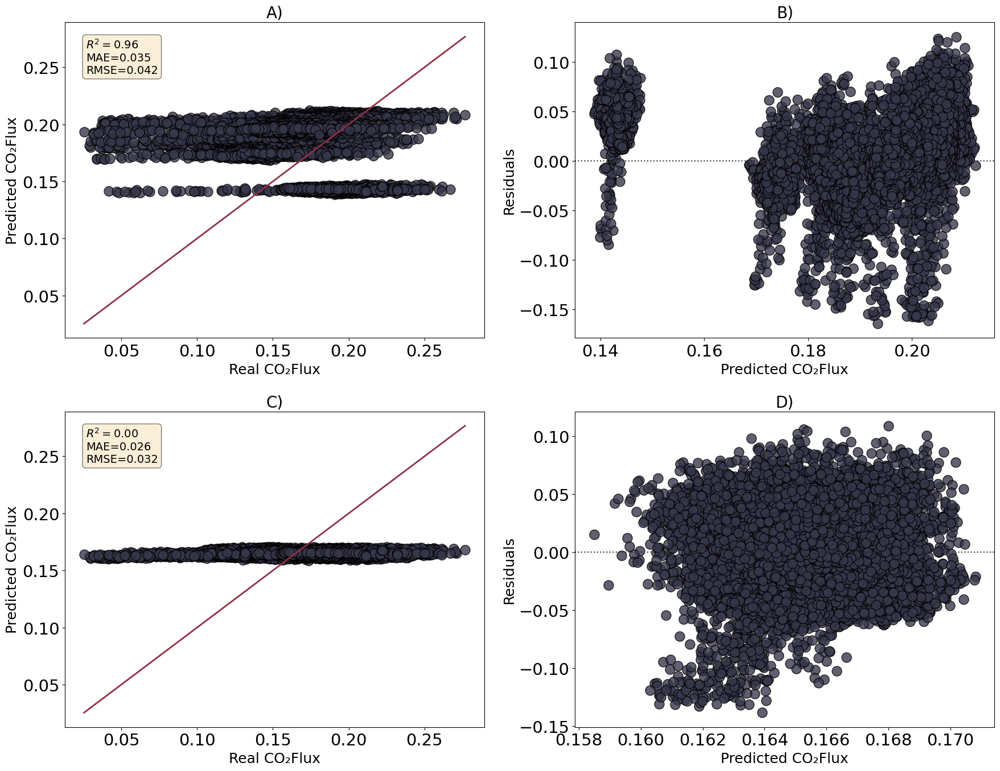

In [ ]:
import pandas as pd
import numpy as np
import statsmodels.api as sm
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
import matplotlib.pyplot as plt
import seaborn as sns

# Definir as variáveis independentes (VH) e dependentes (CO2)
X = bacon_11['VH']
y = bacon_11['CO2']

# Adicionar uma constante (intercepto) ao modelo
X_const = sm.add_constant(X)

# Regressão Ponderada
weights = bacon_11['Angulo']
X_weighted = X_const.multiply(weights, axis=0)
y_weighted = y.multiply(weights, axis=0)

# Ajustar o modelo de regressão linear ponderado
model_weighted = sm.OLS(y_weighted, X_weighted).fit()

# Prever os valores de CO2 com o modelo ponderado ajustado
y_pred_weighted = model_weighted.predict(X_weighted)

# Calcular resíduos ponderados
residuals_weighted = y - y_pred_weighted

# Regressão Simples (Sem Ponderação)
model_simple = sm.OLS(y, X_const).fit()

# Prever os valores de CO2 com o modelo simples ajustado
y_pred_simple = model_simple.predict(X_const)

# Calcular resíduos simples
residuals_simple = y - y_pred_simple

# Cálculo do MAE e RMSE
mae_weighted = np.mean(np.abs(residuals_weighted))
rmse_weighted = np.sqrt(np.mean(residuals_weighted**2))

mae_simple = np.mean(np.abs(residuals_simple))
rmse_simple = np.sqrt(np.mean(residuals_simple**2))

# Criar os subplots (2x2)
fig, axes = plt.subplots(2, 2, figsize=(18, 14))

# Ajustar o tamanho da fonte geral
plt.rcParams.update({'font.size': 21})

# Subplot 1: Valores reais vs preditos (Ponderado)
sns.scatterplot(x=y, y=y_pred_weighted, ax=axes[0, 0],
                s=150, color='#38384c', alpha=0.8, edgecolor='Black')
sns.lineplot(x=[y.min(), y.max()], y=[y.min(), y.max()], ax=axes[0, 0], color='#902e44', linestyle='-', lw=2)
axes[0, 0].set_xlabel('Real CO₂Flux', fontsize=18)
axes[0, 0].set_ylabel('Predicted CO₂Flux', fontsize=18)
axes[0, 0].set_title('A)', fontsize=20, loc='center')

# Adicionar caixa de texto com métricas
textstr_weighted = '\n'.join((
    f'$R^2={model_weighted.rsquared:.2f}$',
    f'MAE={mae_weighted:.3f}',
    f'RMSE={rmse_weighted:.3f}',
))
props = dict(boxstyle='round', facecolor='wheat', alpha=0.5)
axes[0, 0].text(0.05, 0.95, textstr_weighted, transform=axes[0, 0].transAxes,
                fontsize=14, verticalalignment='top', bbox=props)

# Subplot 2: Gráfico de resíduos (Ponderado)
sns.residplot(x=y_pred_weighted, y=y_weighted, line_kws=dict(color="#902e44"),
              ax=axes[0, 1], scatter_kws={'s': 150, 'color': '#38384c', 'alpha': 0.8, 'edgecolor':'Black'})
axes[0, 1].set_xlabel('Predicted CO₂Flux', fontsize=18)
axes[0, 1].set_ylabel('Residuals', fontsize=18)
axes[0, 1].set_title('B)', fontsize=20, loc='center')

# Subplot 3: Valores reais vs preditos (Simples)
sns.scatterplot(x=y, y=y_pred_simple, ax=axes[1, 0],
                s=150, color='#38384c', alpha=0.8, edgecolor='Black')
sns.lineplot(x=[y.min(), y.max()], y=[y.min(), y.max()], ax=axes[1, 0], color='#902e44', linestyle='-', lw=2)
axes[1, 0].set_xlabel('Real CO₂Flux', fontsize=18)
axes[1, 0].set_ylabel('Predicted CO₂Flux', fontsize=18)
axes[1, 0].set_title('C)', fontsize=20, loc='center')

# Adicionar caixa de texto com métricas
textstr_simple = '\n'.join((
    f'$R^2={model_simple.rsquared:.2f}$',
    f'MAE={mae_simple:.3f}',
    f'RMSE={rmse_simple:.3f}',
))
props = dict(boxstyle='round', facecolor='wheat', alpha=0.5)
axes[1, 0].text(0.05, 0.95, textstr_simple, transform=axes[1, 0].transAxes,
                fontsize=14, verticalalignment='top', bbox=props)

# Subplot 4: Gráfico de resíduos (Simples)
sns.residplot(x=y_pred_simple, y=y, line_kws=dict(color="#902e44"),
              ax=axes[1, 1], scatter_kws={'s': 150, 'color': '#38384c', 'alpha': 0.8, 'edgecolor':'Black'})
axes[1, 1].set_xlabel('Predicted CO₂Flux', fontsize=18)
axes[1, 1].set_ylabel('Residuals', fontsize=18)
axes[1, 1].set_title('D)', fontsize=20, loc='center')

# Ajustar layout e exibir os gráficos
plt.tight_layout()
plt.savefig('regression_plots_2x2.png', dpi=300)
plt.show()


                                 OLS Regression Results                                
Dep. Variable:                      y   R-squared (uncentered):                   0.964
Model:                            OLS   Adj. R-squared (uncentered):              0.964
Method:                 Least Squares   F-statistic:                          2.676e+05
Date:                Thu, 29 Aug 2024   Prob (F-statistic):                        0.00
Time:                        22:48:07   Log-Likelihood:                          43638.
No. Observations:               20196   AIC:                                 -8.727e+04
Df Residuals:                   20194   BIC:                                 -8.726e+04
Df Model:                           2                                                  
Covariance Type:            nonrobust                                                  
                 coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------

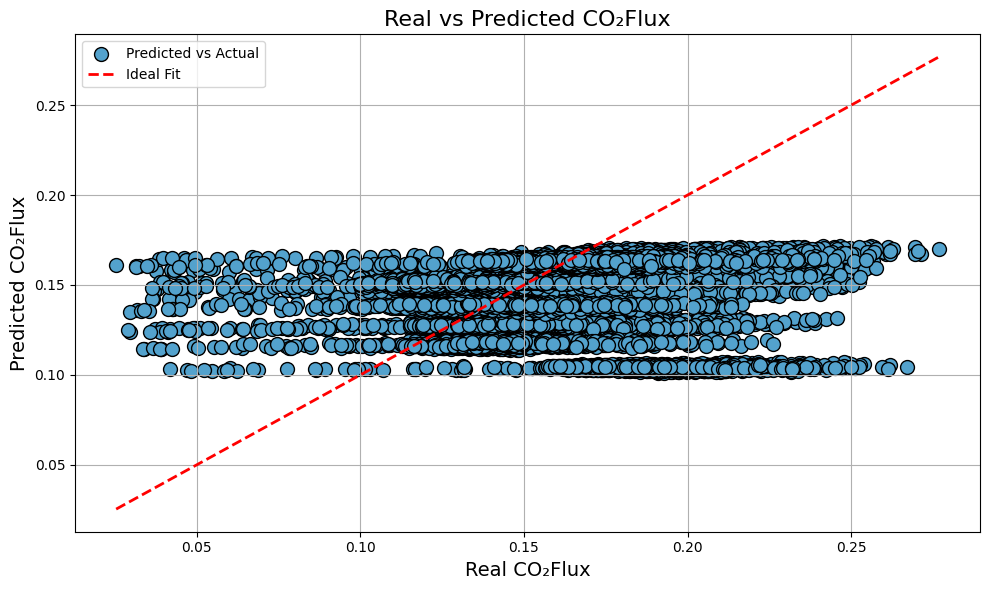

In [ ]:
import pandas as pd
import numpy as np
import statsmodels.api as sm
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
import matplotlib.pyplot as plt

# Definir as variáveis independentes (VH) e dependentes (CO2)
X = bacon_11[['VH']]
y = bacon_11['CO2']

# Normalizar as variáveis independentes (VH)
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Adicionar a constante (intercepto) ao modelo normalizado
X_scaled = sm.add_constant(X_scaled)

valor = 'Norma_Vetor'

#Norma_Vetor	Angulo	Angulo_Graus

# Ponderar os valores de X e y pelos valores de Norma_Vetor
weights = bacon_11[valor] / bacon[valor].max()  # Normalizar os pesos
X_weighted = X_scaled * weights.values[:, np.newaxis]
y_weighted = y * weights

# Ajustar o modelo de regressão linear ponderado
model = sm.OLS(y_weighted, X_weighted).fit()

# Exibir o sumário do modelo
summary = model.summary()
print(summary)

# Prever os valores de CO2 com o modelo ajustado
y_pred = model.predict(X_weighted)

# Calcular R², MAE e RMSE
r2 = r2_score(y, y_pred)
mae = mean_absolute_error(y, y_pred)
rmse = np.sqrt(mean_squared_error(y, y_pred))

# Exibir as métricas
print(f"R²: {r2:.4f}")
print(f"MAE: {mae:.4f}")
print(f"RMSE: {rmse:.4f}")

# Plotar os valores reais vs preditos
plt.figure(figsize=(10, 6))
plt.scatter(y, y_pred, color='#53a2cd', edgecolor='k', s=100, label='Predicted vs Actual')
plt.plot([y.min(), y.max()], [y.min(), y.max()], 'r--', lw=2, label='Ideal Fit')
plt.xlabel('Real CO₂Flux', fontsize=14)
plt.ylabel('Predicted CO₂Flux', fontsize=14)
plt.title('Real vs Predicted CO₂Flux', fontsize=16)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.savefig('regression_real_vs_predicted.png', dpi=300)
plt.show()


In [ ]:
coef = model.params
intercept = coef[0]  # Intercepto
slope = coef[1]      # Coeficiente de VH

print(f"Intercepto: {intercept:.4f}")
print(f"Coeficiente de VH: {slope:.4f}")


Intercepto: 0.1861
Coeficiente de VH: 0.0156


<ipython-input-10-01ca25d99fe3>:3: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  intercept = coef[0]  # Intercepto
<ipython-input-10-01ca25d99fe3>:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  slope = coef[1]      # Coeficiente de VH
